In [1]:
import os, sys, time, tqdm, importlib, pickle
import numpy as np
import pandas as pd
import pathlib
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import style
import seaborn as sns
import scanpy as sc
import spatialdata as sd
import squidpy as sq
import scipy.stats as ss
from scipy.spatial.distance import cdist
import gseapy

import warnings
warnings.filterwarnings('ignore')

style.use('seaborn-v0_8-white')
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

/home/xiaojiashun/anaconda3/envs/SpatialScope/lib/python3.9/site-packages/dask/dataframe/_pyarrow_compat.py:15: FutureWarning: Minimal version of pyarrow will soon be increased to 14.0.1. You are using 9.0.0. Please consider upgrading.
  warnings.warn(


In [2]:
## ct map
ct_map = {'B_GC': ['B_Cycling', 'B_GC_DZ', 'B_GC_LZ', 'B_GC_prePB'],
          'B_mem': ['B_IFN', 'B_activated', 'B_mem', 'B_naive', 'B_preGC'],
          'B_plasma': ['B_plasma'],
          'DC': ['DC_CCR7+', 'DC_cDC1', 'DC_cDC2', 'DC_pDC'],
          'Endo': ['Endo'],
          'FDC': ['FDC'],
          'ILC': ['ILC'],
          'Macrophaeges': ['Macrophages_M1', 'Macrophages_M2'],
          'Myeloids': ['Mast', 'Monocytes'],
          'NK': ['NK'],
          'T': ['NKT', 'T_CD4+', 'T_CD4+_TfH', 'T_CD4+_TfH_GC', 'T_CD8+_CD161+', 'T_CD8+_cytotoxic', 'T_TIM3+', 'T_TfR', 'T_Treg'],
          'T_naive': ['T_CD4+_naive', 'T_CD8+_naive'],
          'Stromal': ['VSMC']}
ct_map_inv = {}
for k, v in ct_map.items():
    for x in v:
        ct_map_inv[x] = k

In [3]:
import utils
importlib.reload(utils)
from utils import *

# Data

In [7]:
crop_id = 2

## Preprocess

### Label and basic preprocess

In [4]:
data_dir = '/data2/xiaojiashun/niche/data/Xenium/Xenium_Prime_Human_Lymph_Node_Reactive_FFPE_outs/three_crops'

In [5]:
crop = sc.read(f'{data_dir}/crop{crop_id}_raw.h5ad')
print(f'Raw: {len(crop)} cells.')

Raw: 192378 cells.


In [6]:
crop

AnnData object with n_obs × n_vars = 192378 × 4624
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level', 'cell_labels', 'x', 'y', 'group'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [8]:
## cell type label
chunk1 = pd.read_csv(f'{data_dir}/cell2location_info_crop{crop_id}_chunk1.csv', sep='\t', index_col=0)
chunk2 = pd.read_csv(f'{data_dir}/cell2location_info_crop{crop_id}_chunk2.csv', sep='\t', index_col=0)
chunks = pd.concat([chunk1, chunk2], axis=0)
chunks.index = chunks.index.astype(str)
print(chunk1.shape, chunk2.shape, chunks.shape)
chunks['sub_cell_type'] = chunks['cell_type']
chunks['cell_type'] = chunks['sub_cell_type'].map(ct_map_inv)
obs = crop.obs.copy()
merge = pd.merge(obs, chunks[['max_abun', 'max_norm', 'cell_type', 'sub_cell_type']], 
                 left_index=True, right_index=True, how='left')
crop.obs = merge.copy()
crop.obs['cell_type'] = crop.obs['cell_type'].astype('category')
crop.obs['sub_cell_type'] = crop.obs['sub_cell_type'].astype('category')

(100000, 40) (92378, 40) (192378, 40)


In [9]:
crop.obs.groupby('cell_type').size()

cell_type
B_GC            10706
B_mem           19679
B_plasma         7908
DC              14193
Endo            20657
FDC              3936
ILC               519
Macrophaeges    18504
Myeloids         2054
NK               2174
Stromal         24234
T               23311
T_naive         44503
dtype: int64

In [10]:
## basic preprocess
np.unique(crop.obs.nucleus_count, return_counts=True)

(array([0., 1., 2., 3., 4., 5., 6., 7.]),
 array([  1672, 179122,  10561,    912,     92,     15,      2,      2]))

In [11]:
sc.pp.filter_cells(crop, min_counts=100)
sc.pp.filter_cells(crop, max_counts=5000)
sc.pp.filter_genes(crop, min_cells=5)
crop

AnnData object with n_obs × n_vars = 168790 × 4623
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level', 'cell_labels', 'x', 'y', 'group', 'max_abun', 'max_norm', 'cell_type', 'sub_cell_type', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

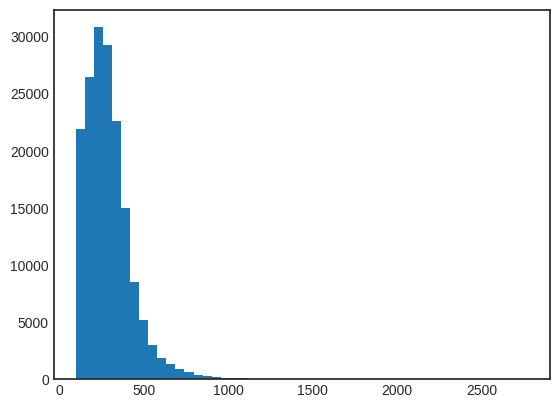

In [12]:
plt.hist(np.array(crop.X.sum(1))[:,0], bins=50)
plt.show()

In [13]:
np.median(np.array(crop.X.sum(1))[0])

616.0

In [14]:
crop.raw = crop
crop.layers['counts'] = crop.X.copy()
t0 = time.time()
sc.pp.normalize_total(crop)
sc.pp.highly_variable_genes(crop, flavor='seurat_v3',n_top_genes=3000)
sc.pp.log1p(crop)
sc.pp.pca(crop, svd_solver='arpack', n_comps=30, use_highly_variable=True)
sc.pp.neighbors(crop, metric='cosine', n_neighbors=30, n_pcs = 30)
sc.tl.umap(crop)
print(f'{time.time() - t0:.1f}s')

107.4s


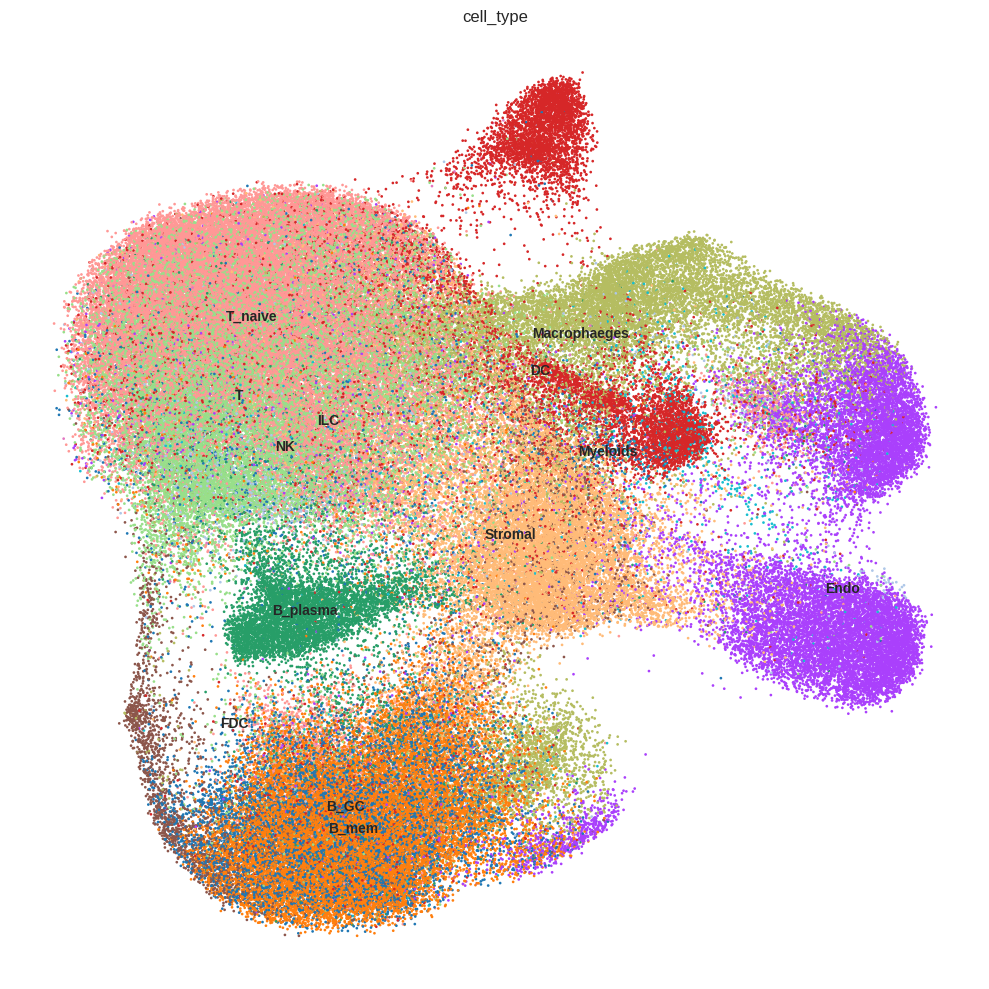

In [15]:
fig, axs = plt.subplots(1, 1, figsize=(10, 10))
sc.pl.umap(crop,  size=15, color='cell_type', frameon=False, show=False, ax=axs,legend_loc='on data')
plt.tight_layout()

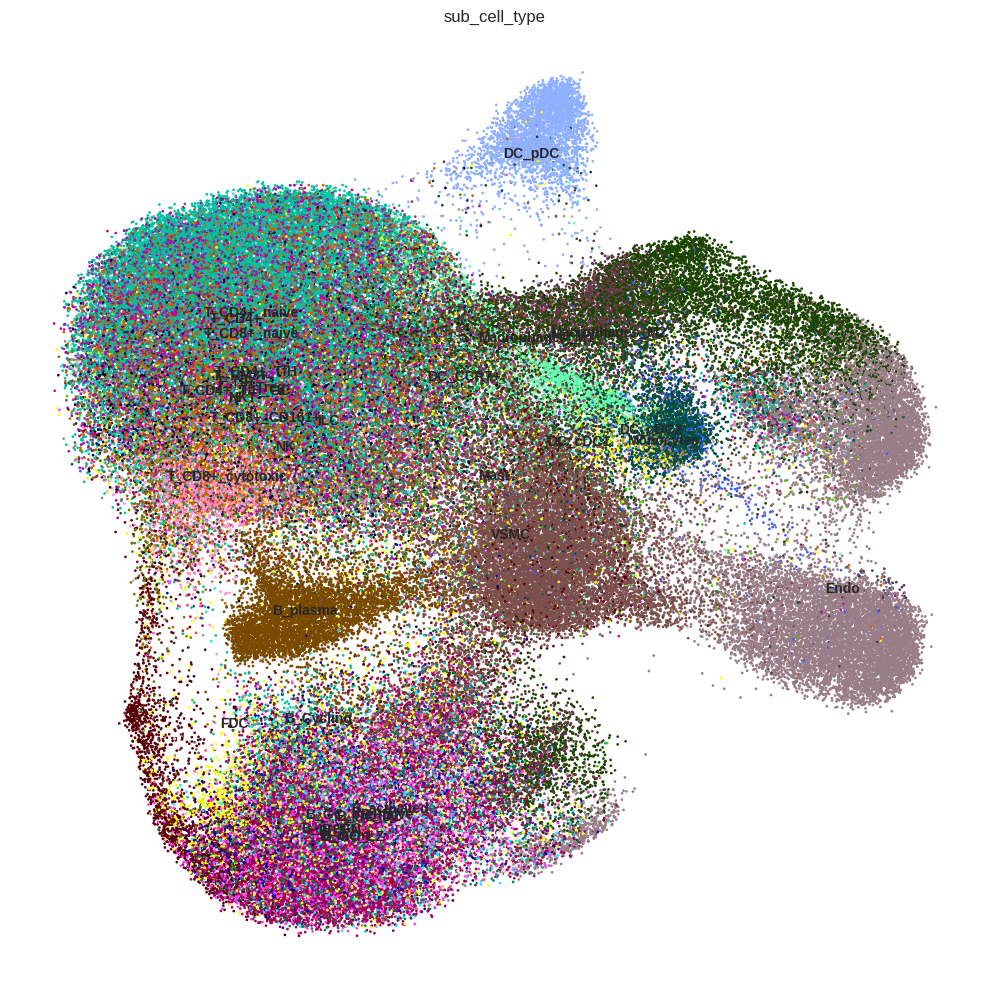

In [16]:
fig, axs = plt.subplots(1, 1, figsize=(10, 10))
sc.pl.umap(crop,  size=15, color='sub_cell_type', frameon=False, show=False, ax=axs,legend_loc='on data')
plt.tight_layout()

In [17]:
crop.X.max(), crop.layers['counts'].max()

(4.1009893, 93.0)

In [18]:
print(f'After basic preprocessing: {len(crop)} cells.')

After basic preprocessing: 168790 cells.


In [19]:
## save crop after prepro
crop.write(f'{data_dir}/crop{crop_id}_prepro.h5ad')

### QC

In [100]:
## load crop with prepro
crop = sc.read(f'{data_dir}/crop{crop_id}_prepro.h5ad')
print(f'Before QC: {len(crop)} cells.')

Before QC: 168790 cells.


In [101]:
## qc by label confidence
conf = 0.3
obs = crop.obs.copy()
qc_df = obs.loc[obs['max_norm']>conf]
qc_df = qc_df.groupby('cell_type').filter(lambda x: len(x) >= 100)
qc_df = qc_df.groupby('sub_cell_type').filter(lambda x: len(x) >= 100)
obs['pass_qc'] = False
obs.loc[qc_df.index,'pass_qc'] = True
crop.obs = obs.copy()
crop = crop[crop.obs.pass_qc==True,:]
# crop = crop[crop.obs.cell_type!='VSMC']
print(f'After QC: {len(crop)} cells.')

After QC: 74851 cells.


In [27]:
## save crop after qc
crop.write(f"{data_dir}/crop{crop_id}_conf{str(conf).replace('.','')}.h5ad")

## QC summary

In [102]:
all_cts = crop.obs.cell_type.cat.categories
crop.obs.groupby('cell_type')['max_norm'].agg(['size', 'median'])

,size,median
cell_type,,
B_GC,4071,0.461015
B_mem,6653,0.449872
B_plasma,5398,0.738523
DC,9210,0.688689
Endo,13980,0.685016
FDC,1897,0.468519
ILC,186,0.509806
Macrophaeges,10150,0.511419
Myeloids,967,0.600093


In [103]:
all_subcts = crop.obs.sub_cell_type.cat.categories
print(len(all_subcts))
crop.obs.groupby('sub_cell_type')['max_norm'].agg(['size', 'median'])

30


,size,median
sub_cell_type,,
B_Cycling,1881,0.516160
B_GC_DZ,515,0.390305
B_GC_LZ,1675,0.435375
B_IFN,628,0.402086
B_activated,116,0.389213
B_mem,4623,0.471568
B_naive,696,0.401941
B_plasma,5398,0.738523
B_preGC,590,0.466381


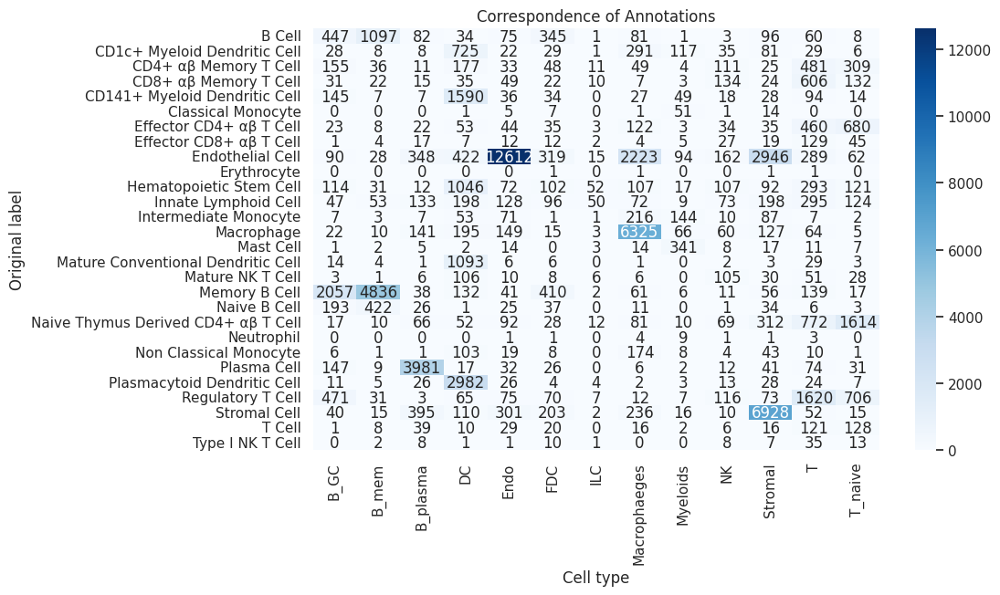

In [104]:
# Create a contingency matrix
contingency_matrix = pd.crosstab(crop.obs['group'],crop.obs['cell_type'])

# Plotting the heatmap
plt.figure(figsize=(10, 6), dpi=100)
sns.heatmap(contingency_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Correspondence of Annotations')
plt.xlabel('Cell type')
plt.ylabel('Original label')
plt.show()

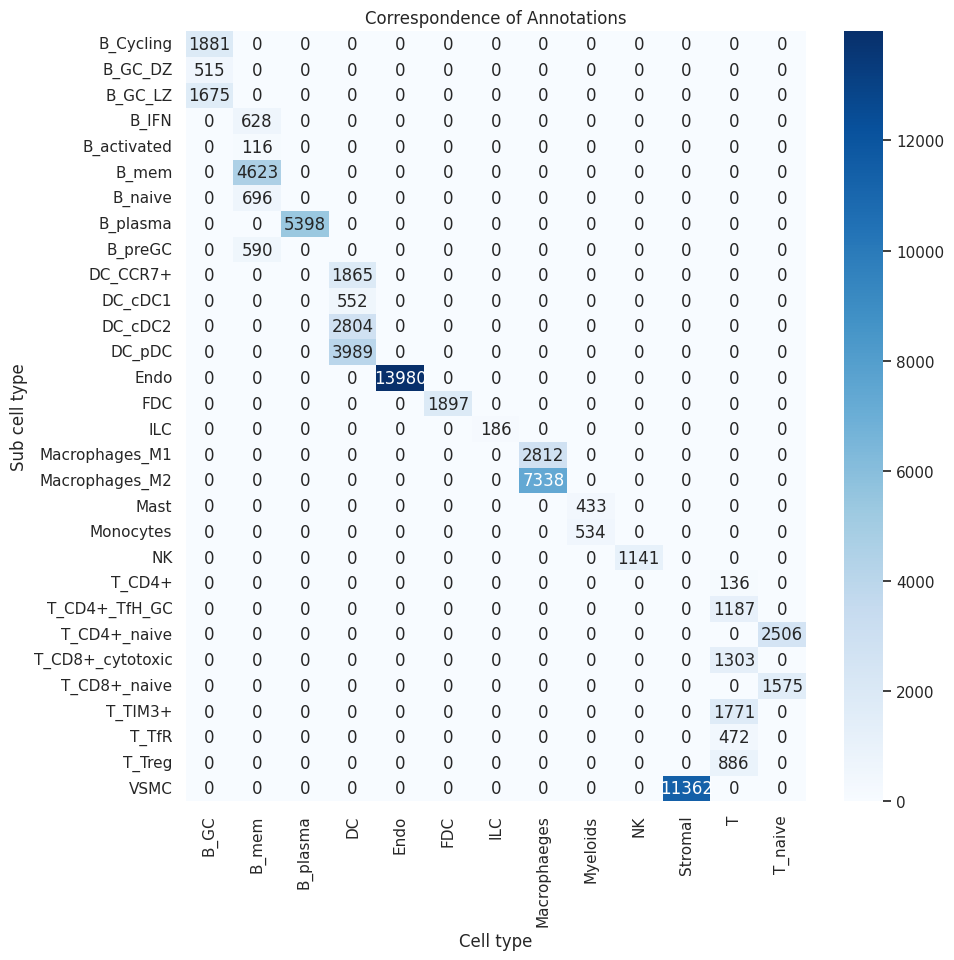

In [105]:
# Create a contingency matrix
contingency_matrix = pd.crosstab(crop.obs['sub_cell_type'],crop.obs['cell_type'])

# Plotting the heatmap
plt.figure(figsize=(10, 10), dpi=100)
sns.heatmap(contingency_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Correspondence of Annotations')
plt.xlabel('Cell type')
plt.ylabel('Sub cell type')
plt.show()

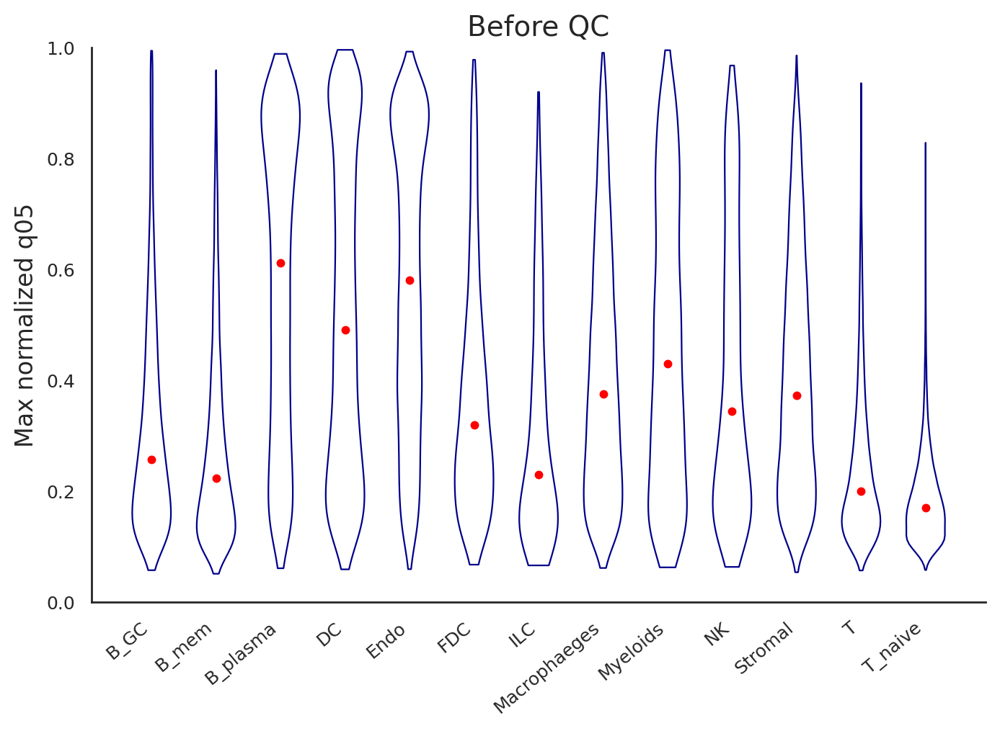

In [106]:
sns.set_context('paper',font_scale=1)
fig, ax = plt.subplots(1, 1, figsize=(8, 5), dpi=200)
width = 0.6
df = chunks[['cell_type', 'max_norm']].copy()
xticks = df.groupby('cell_type').median().index.values
for i, k in enumerate(xticks):
    v_plot = df.loc[df.cell_type==k,'max_norm'].values
    vio1 = ax.violinplot(v_plot, positions=[i], widths=width, 
                         showextrema=False, showmedians=False,showmeans=False)
    for pc in vio1['bodies']:
        pc.set_facecolor('none')
        pc.set_edgecolor('darkblue')
        pc.set_alpha(1)
    means = np.mean(v_plot)
    quartile1, medians, quartile3 = np.percentile(v_plot, [25, 50, 75])
    ax.scatter([i], [medians], marker='o', color='red', s=12, zorder=4)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_ylabel('Max normalized q05', fontsize=12)
ax.set_xticks(range(len(xticks)))
ax.set_xticklabels(xticks, rotation=40, ha='right')
ax.set_title('Before QC', fontsize=14)
ax.set_ylim((0,1))
ax.tick_params(axis='both', which='major', labelsize=9)

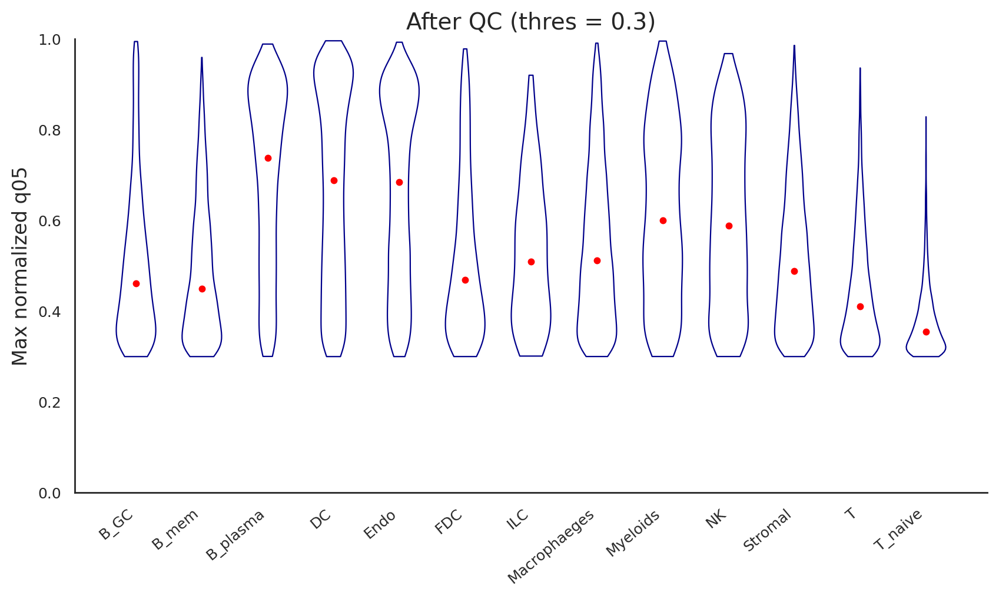

In [107]:
sns.set_context('paper',font_scale=1)
fig, ax = plt.subplots(1, 1, figsize=(10, 5), dpi=200)
width = 0.6
df = qc_df[['cell_type', 'max_norm']].copy()
xticks = df.groupby('cell_type').median().index.values
# xticks = df.groupby('cell_type').median().sort_values('max', ascending=False).index.values
for i, k in enumerate(xticks):
    v_plot = df.loc[df.cell_type==k,'max_norm'].values
    vio1 = ax.violinplot(v_plot, positions=[i], widths=width, 
                         showextrema=False, showmedians=False,showmeans=False)
    for pc in vio1['bodies']:
        pc.set_facecolor('none')
        pc.set_edgecolor('darkblue')
        pc.set_alpha(1)
    means = np.mean(v_plot)
    quartile1, medians, quartile3 = np.percentile(v_plot, [25, 50, 75])
    ax.scatter([i], [medians], marker='o', color='red', s=12, zorder=4)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_ylabel('Max normalized q05', fontsize=12)
ax.set_xticks(range(len(xticks)))
ax.set_xticklabels(xticks, rotation=40, ha='right')
ax.set_ylim((0,1))
ax.set_title(f'After QC (thres = {conf})', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=9)

## Visualize

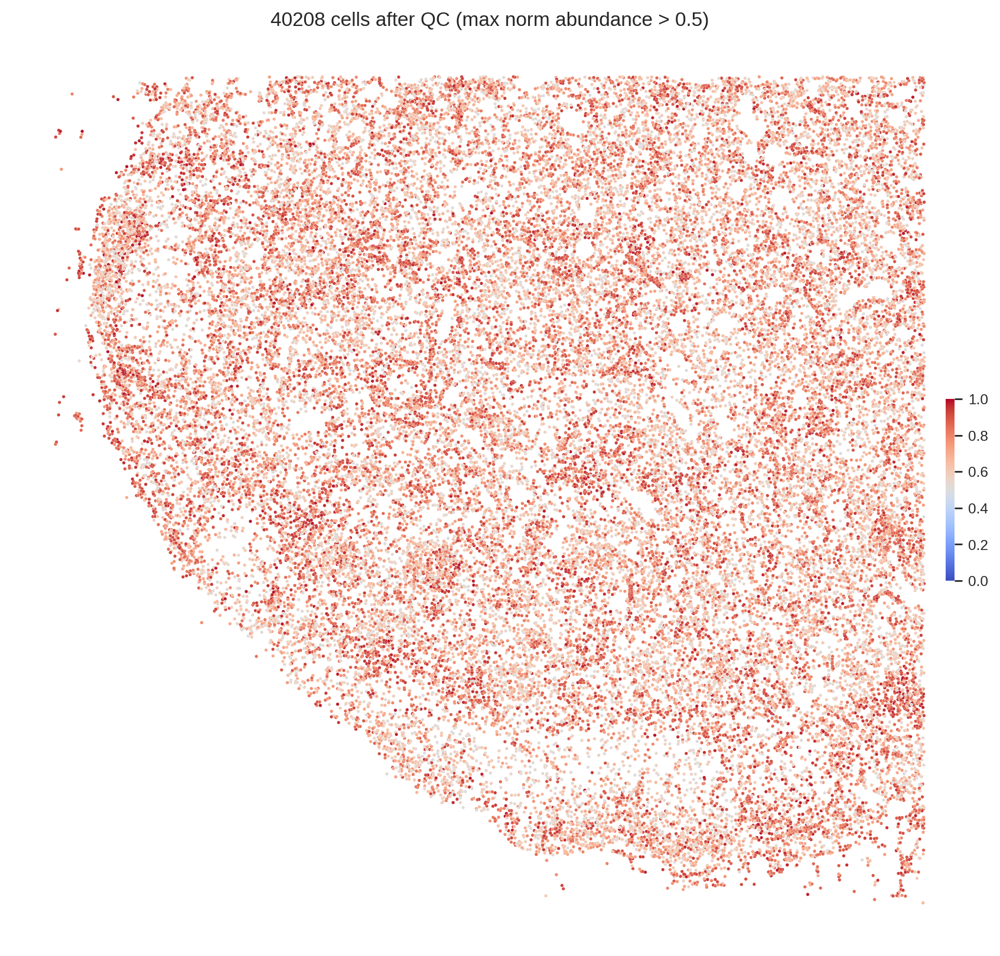

In [36]:
fig, ax = plt.subplots(1, 1, figsize=(12, 10), dpi=200)
sca_draw = crop.obs.copy()
sca = ax.scatter(sca_draw['x'].values, sca_draw['y'].values, 4, sca_draw['max_norm'].values, edgecolor='w', lw=0.1, 
           cmap=plt.cm.coolwarm, vmin=0, vmax=1)
ax.invert_yaxis()
ax.set_xticklabels([])
ax.set_yticklabels([])
for s in ['top', 'bottom', 'right', 'left']:
    ax.spines[s].set_visible(False)
cb = fig.colorbar(sca, shrink=0.2, drawedges=False, pad=-0.02)
cb.outline.set_visible(False)
ax.set_title(f'{len(sca_draw)} cells after QC (max norm abundance > {conf})', fontsize=12)
plt.axis('off')
plt.show()

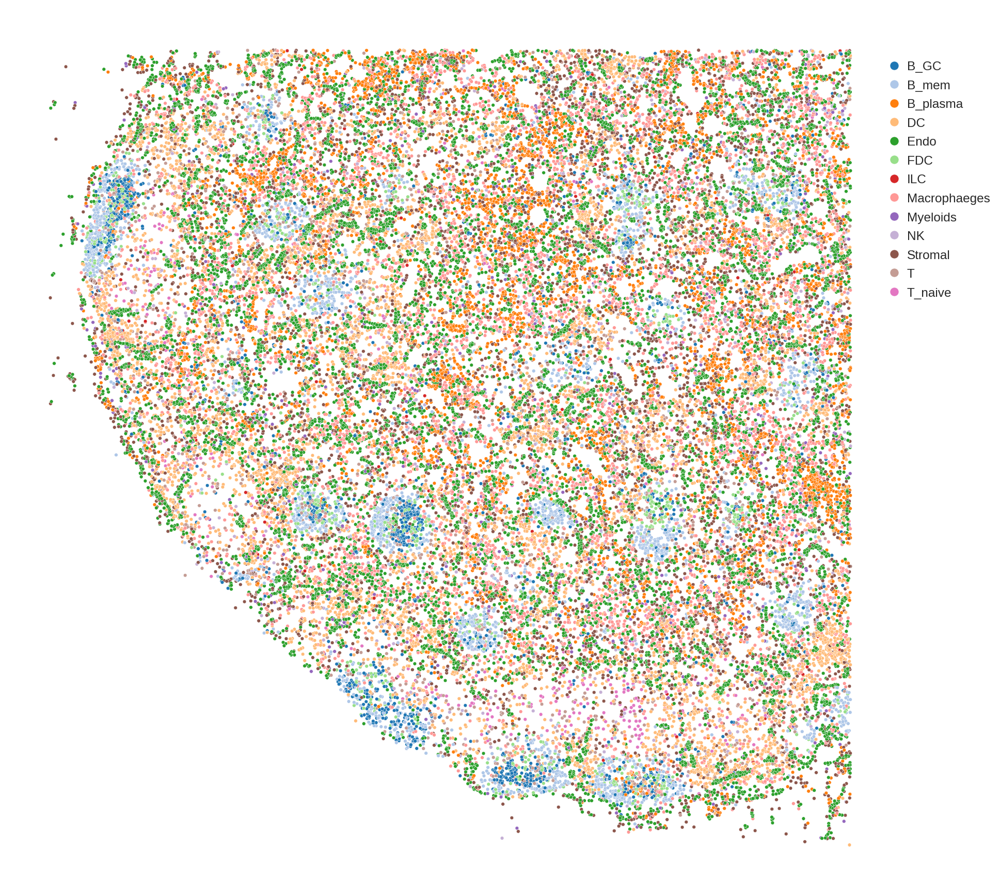

In [37]:
## all cells
plt.subplots(figsize=(11,11), dpi=200)
cts = all_cts
sns.scatterplot(data=crop.obs, x="x", y="y", hue="cell_type", hue_order=cts, s=6, palette='tab20')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

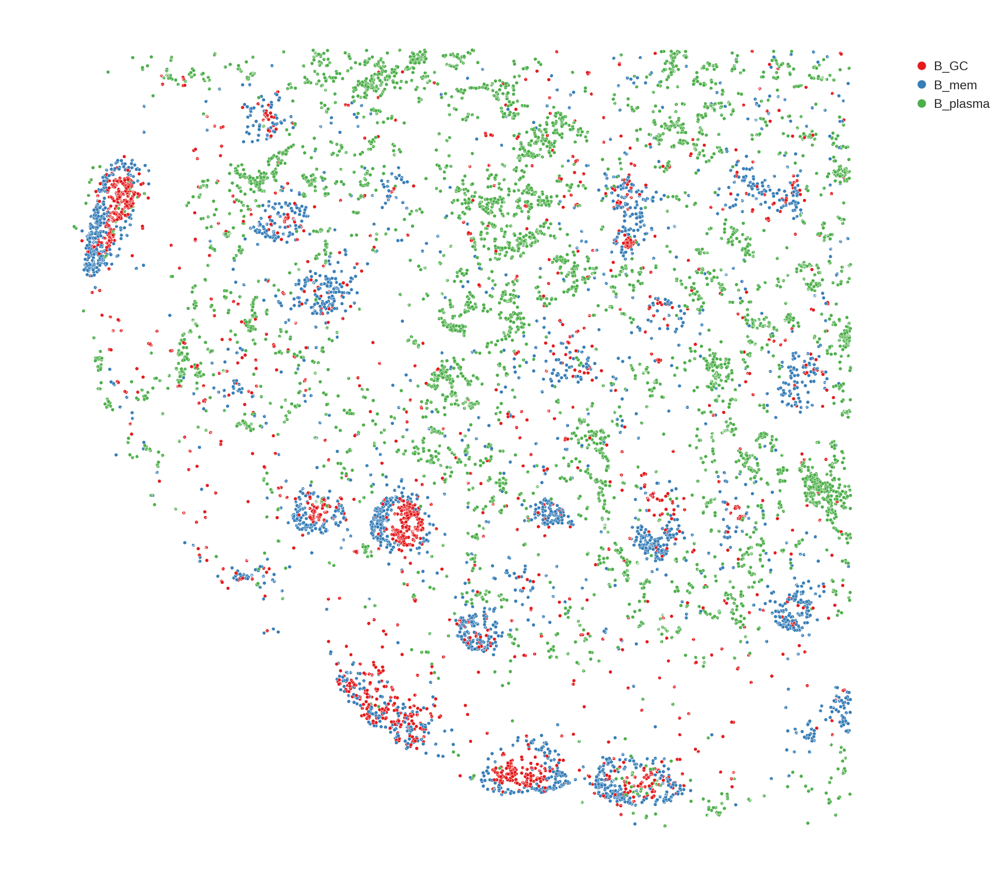

In [38]:
## B cells
plt.subplots(figsize=(11,11), dpi=200)
cts = [x for x in all_cts if x.startswith('B_')]
sns.scatterplot(data=crop.obs, x="x", y="y", hue="cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

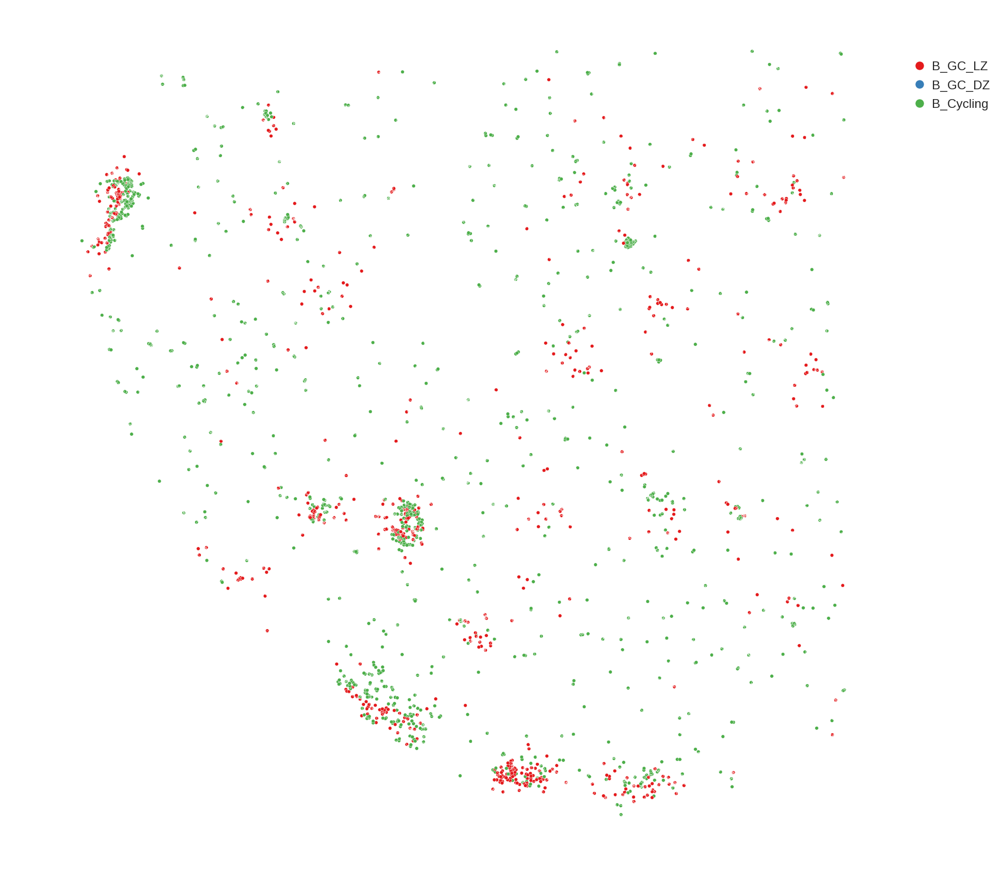

In [39]:
## T cells
plt.subplots(figsize=(11,11), dpi=200)
cts = ['B_GC_LZ', 'B_GC_DZ', 'B_Cycling']
sns.scatterplot(data=crop.obs, x="x", y="y", hue="sub_cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

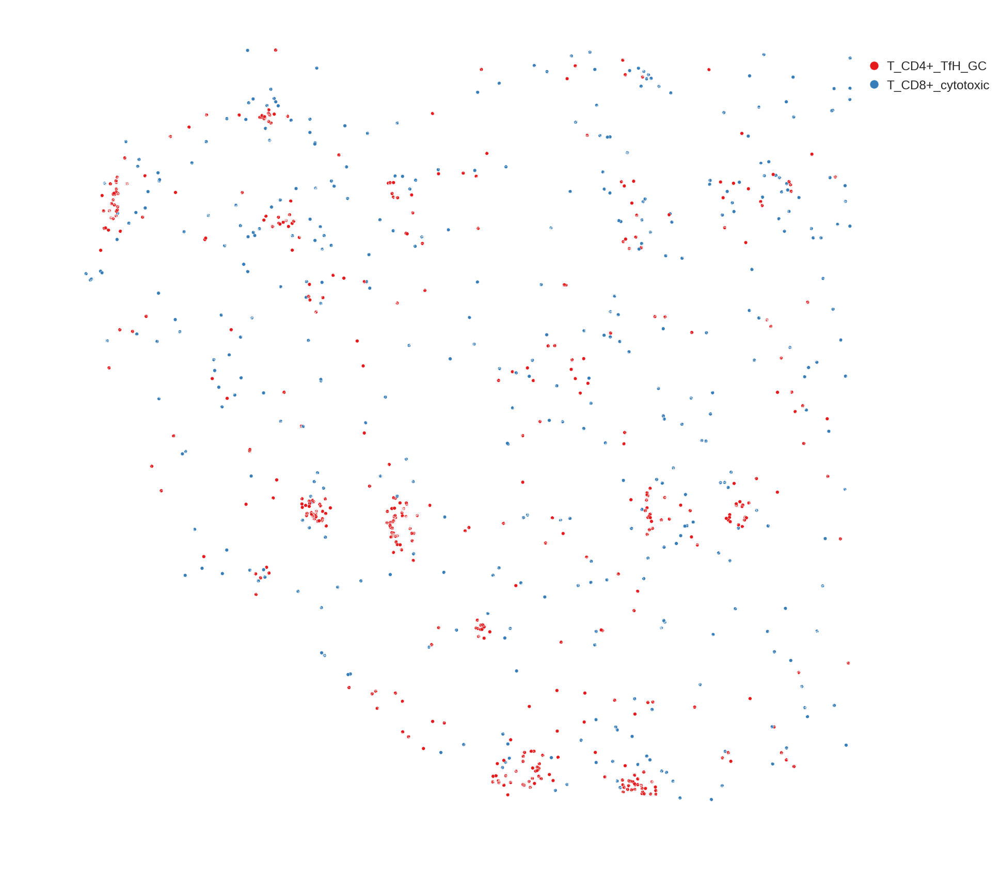

In [40]:
## T cells
plt.subplots(figsize=(11,11), dpi=200)
cts = ['T_CD4+_TfH_GC', 'T_CD8+_cytotoxic']
sns.scatterplot(data=crop.obs, x="x", y="y", hue="sub_cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

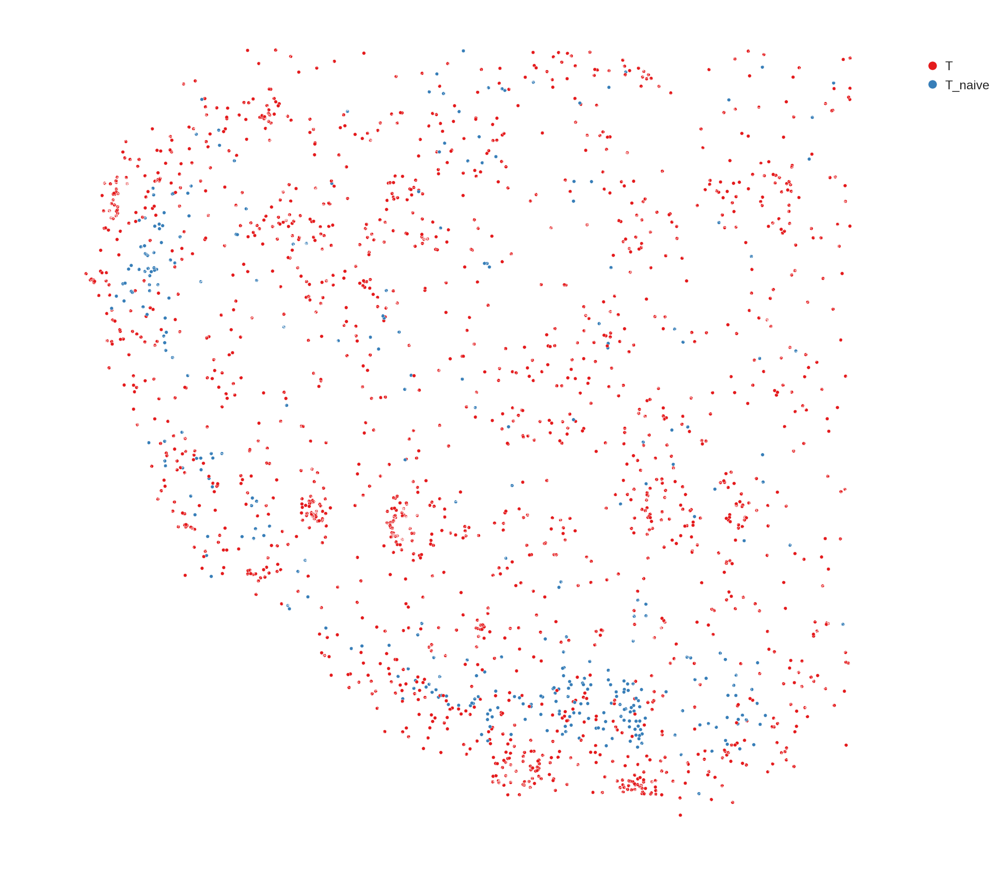

In [41]:
## T cells
plt.subplots(figsize=(11,11), dpi=200)
cts = [x for x in all_cts if x.startswith('T')]
sns.scatterplot(data=crop.obs, x="x", y="y", hue="cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

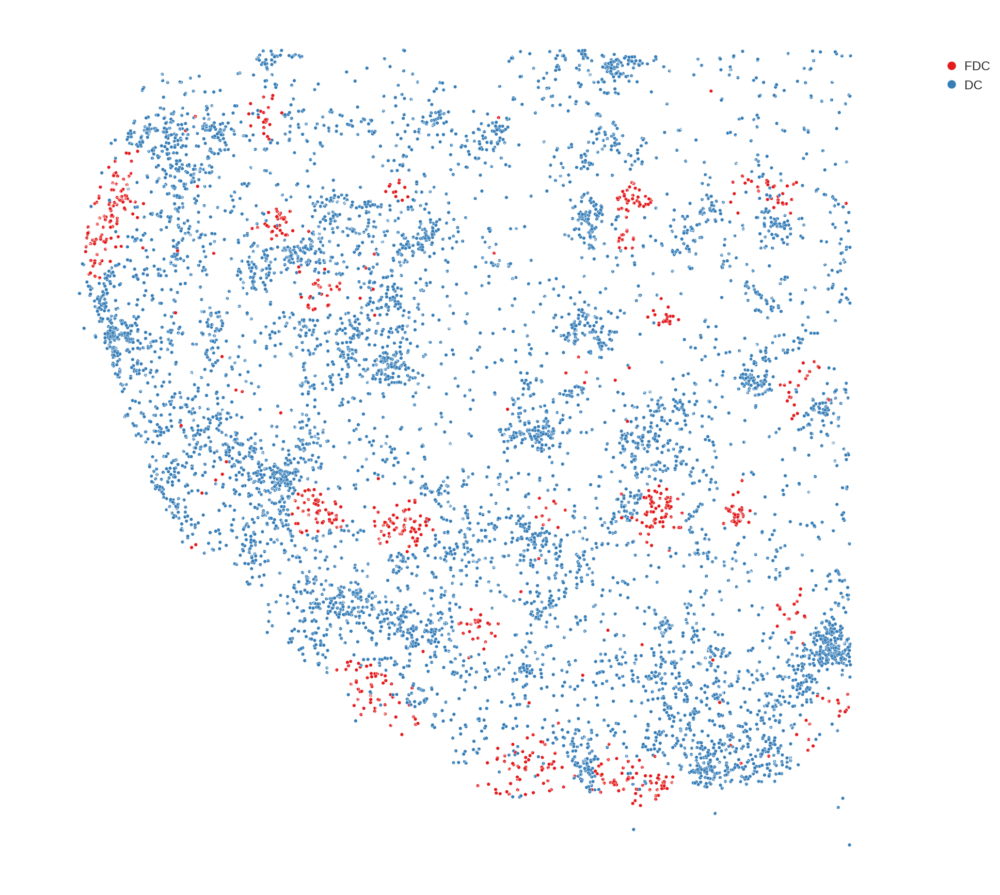

In [42]:
## DC cells
plt.subplots(figsize=(11,11), dpi=200)
cts = ['FDC', 'DC']
sns.scatterplot(data=crop.obs, x="x", y="y", hue="cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

# Neighborhood analysis

## Delaunay

In [43]:
## spatial neighborhood graph
sq.gr.spatial_neighbors(crop, coord_type="generic", delaunay=True) # 2s
sq.gr.nhood_enrichment(crop, cluster_key="cell_type")


00%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:01<00:00, 913.37/s]

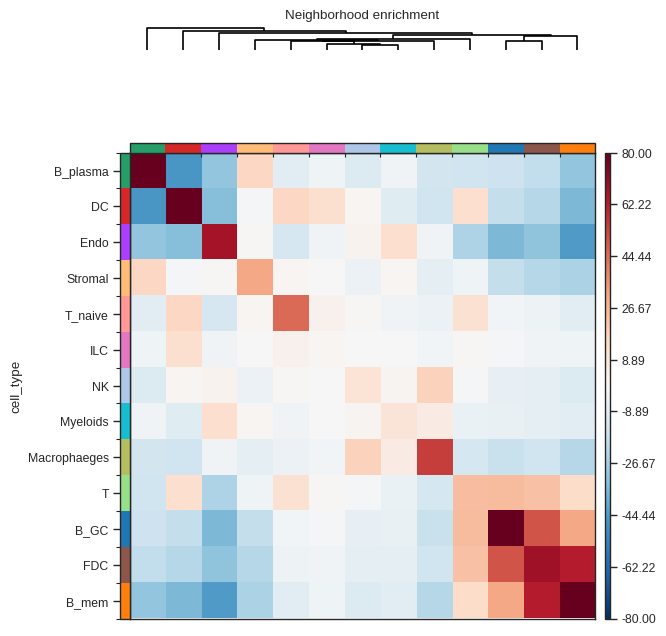

In [44]:
## delaunay
v_ = np.abs(np.array(crop.uns['cell_type_nhood_enrichment']['zscore'])).max()
sq.pl.nhood_enrichment(crop, cluster_key="cell_type", method='single', 
                       figsize=(6, 6), cmap='RdBu_r', vmin=-80, vmax=80)

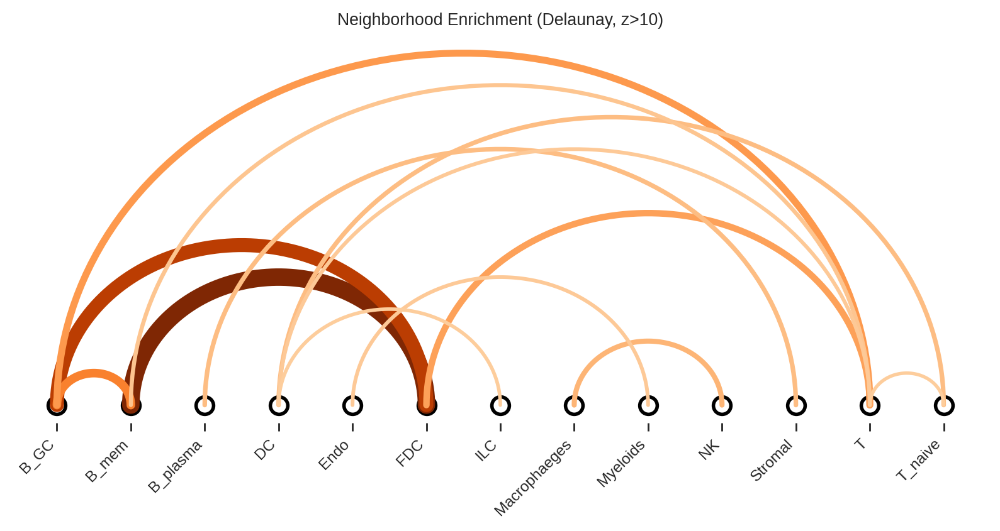

In [45]:
## enriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = 10
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel > zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], zscore[i,j]]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Oranges', figsize=(10, 4), title=f'Neighborhood Enrichment (Delaunay, z>{zs_thres})')

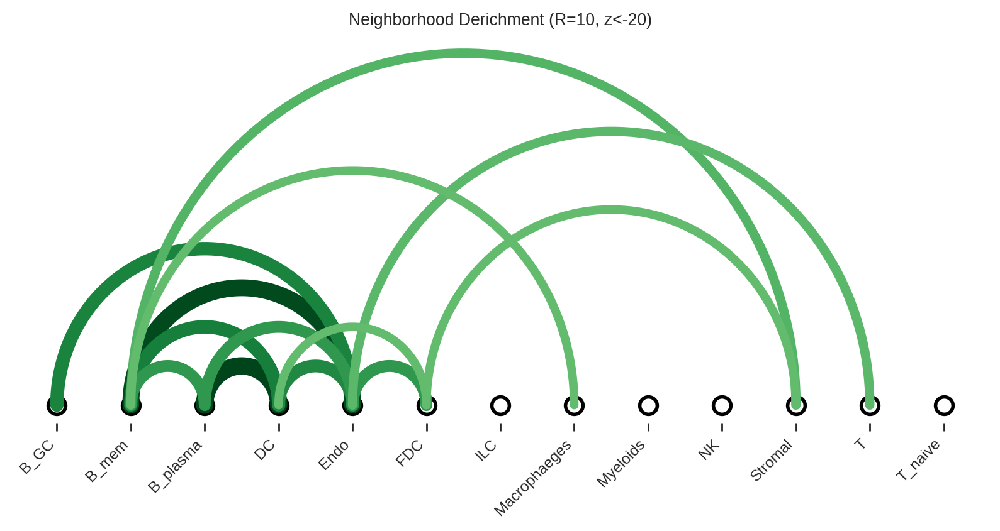

In [46]:
## deriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = -20
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel < zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], abs(zscore[i,j])]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Greens', figsize=(10, 4), title=f'Neighborhood Derichment (R=10, z<{zs_thres})')

## R=10

In [47]:
## spatial neighborhood graph
sq.gr.spatial_neighbors(crop, coord_type="generic", radius=10)
sq.gr.nhood_enrichment(crop, cluster_key="cell_type")


00%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:01<00:00, 992.83/s]

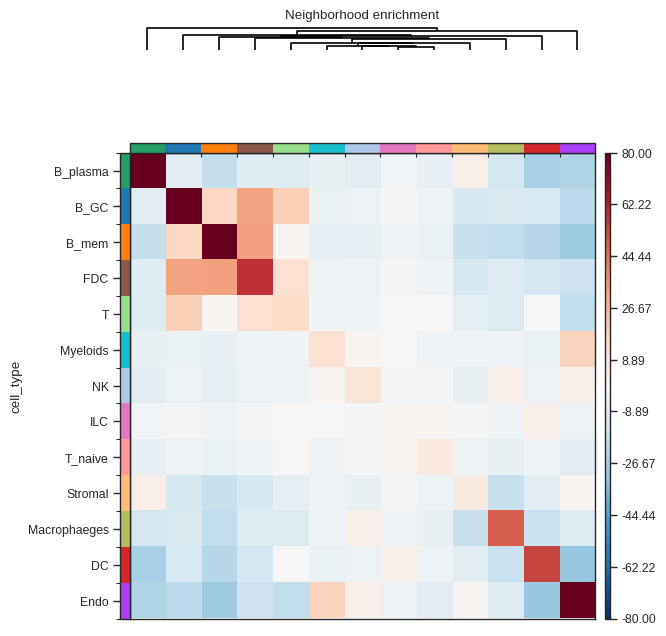

In [48]:
## radius=10
v_ = np.abs(np.array(crop.uns['cell_type_nhood_enrichment']['zscore'])).max()
sq.pl.nhood_enrichment(crop, cluster_key="cell_type", method='single', 
                       figsize=(6, 6), cmap='RdBu_r', vmin=-80, vmax=80)

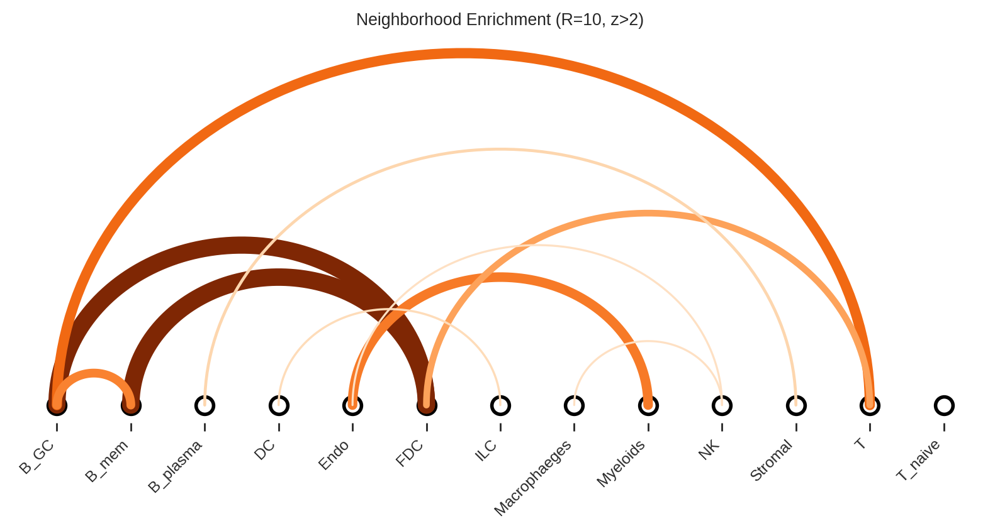

In [49]:
## enriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = 2
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel > zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], zscore[i,j]]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Oranges', figsize=(10, 4), title=f'Neighborhood Enrichment (R=10, z>{zs_thres})')

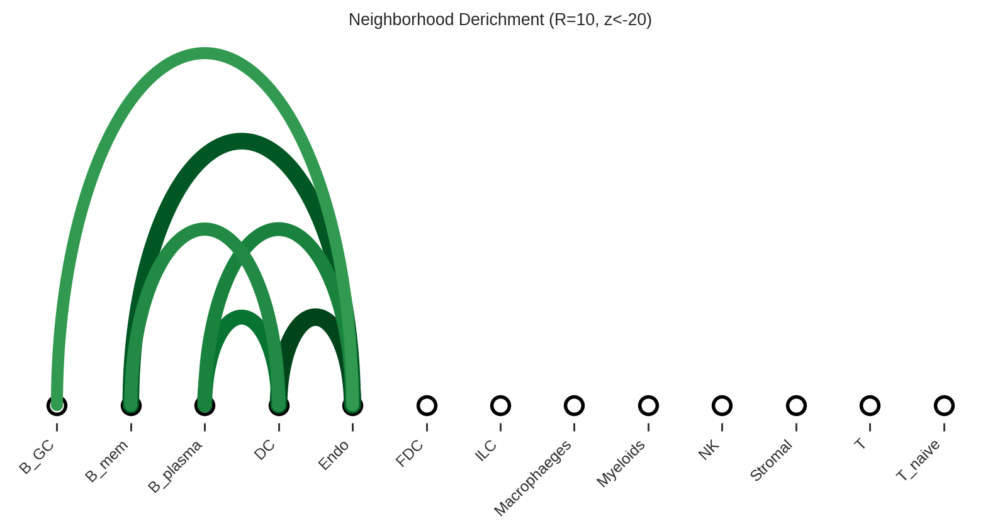

In [50]:
## deriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = -20
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel < zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], abs(zscore[i,j])]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Greens', figsize=(10, 4), title=f'Neighborhood Derichment (R=10, z<{zs_thres})')

## R=20

In [51]:
## spatial neighborhood graph
sq.gr.spatial_neighbors(crop, coord_type="generic", radius=20)
sq.gr.nhood_enrichment(crop, cluster_key="cell_type")


00%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:01<00:00, 880.64/s]

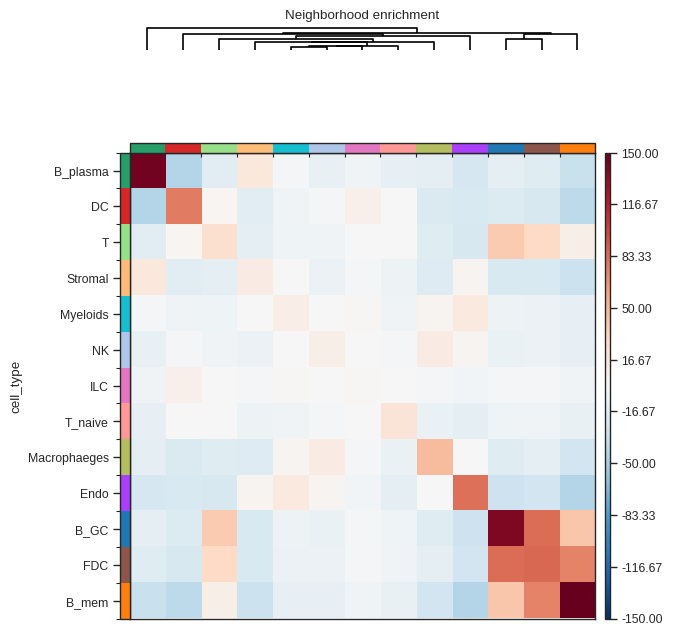

In [52]:
## radius=20
v_ = np.abs(np.array(crop.uns['cell_type_nhood_enrichment']['zscore'])).max()
sq.pl.nhood_enrichment(crop, cluster_key="cell_type", method='single', 
                       figsize=(6, 6), cmap='RdBu_r', vmin=-150, vmax=150)

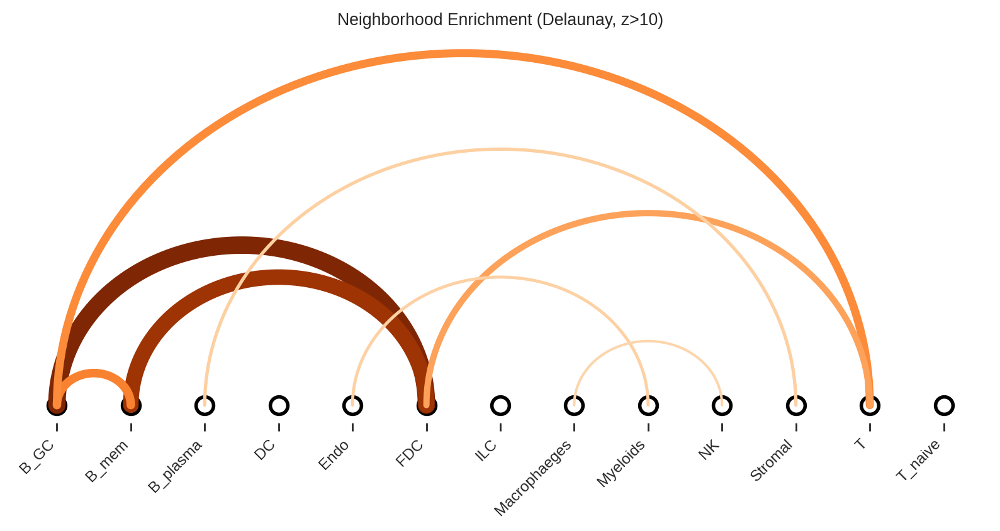

In [53]:
## enriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = 10
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel > zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], zscore[i,j]]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Oranges', figsize=(10, 4), title=f'Neighborhood Enrichment (Delaunay, z>{zs_thres})')

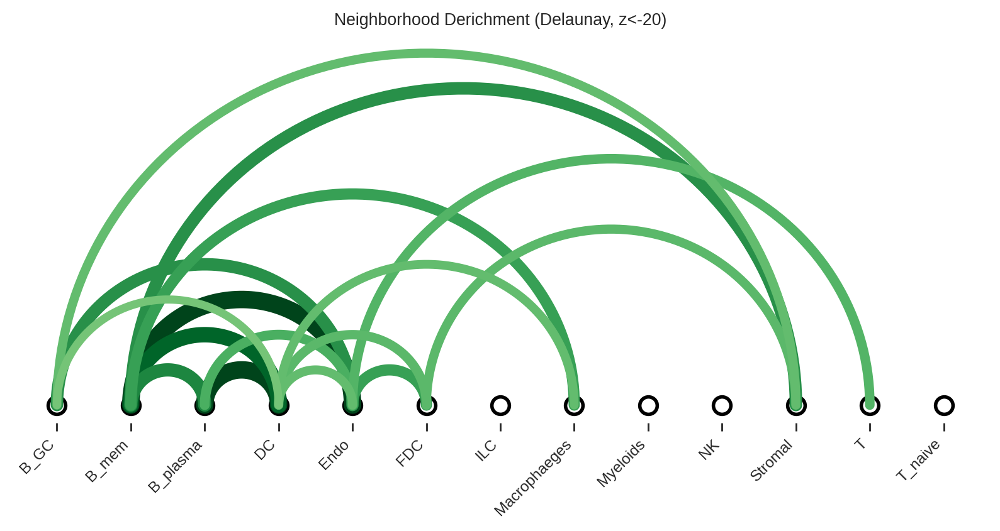

In [54]:
## deriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = -20
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel < zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], abs(zscore[i,j])]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Greens', figsize=(10, 4), title=f'Neighborhood Derichment (Delaunay, z<{zs_thres})')

# Result

In [55]:
save_dir = f"/data2/xiaojiashun/niche/result/Xenium/lymph-trans-label-3crop/subct_conf{str(conf).replace('.','')}"
save_dir

'/data2/xiaojiashun/niche/result/Xenium/lymph-trans-label-3crop/subct_conf05'

## T

In [108]:
## run method
target_ct = 'T'
target_ct_abbr = target_ct
use_cov_test_genes = True
udf, vdf, meta = run_method(crop, target_ct,  target_ct_abbr, self=True,
                       sigma=20, cutoff=0.05, sort_comp_by_corr=False,
                       n_hvg=3000, cov_thres=0.05, cov_test_null=True,
                       use_cov_test_genes=use_cov_test_genes,
                       cca_comp=10, px=0.6, pz=0.4)

***** Niche matrix *****
13 cell_types.
num_cell_ID: (74851, 13).
Use other 13 cell types.
5755 T, 74851 cells in total.

***** Cov test *****
sparkx_X: (2981, 5755); sparkx_N: (5755, 13)
2980 / 2981 genes have pvalue.
Cov test on permuted data...
402 genes with p_adj < 0.05.
Use all 402 genes with p_adj < 0.05.

***** CCA *****
cca_X: (5755, 402); cca_N: (5755, 13)
Nonneg CCA cors: [0.706 0.47  0.505 0.451 0.353 0.3   0.535 0.228 0.269 0.412]
udf: (402, 10); vdf: (13, 10).

T: Finished in 16.1s.


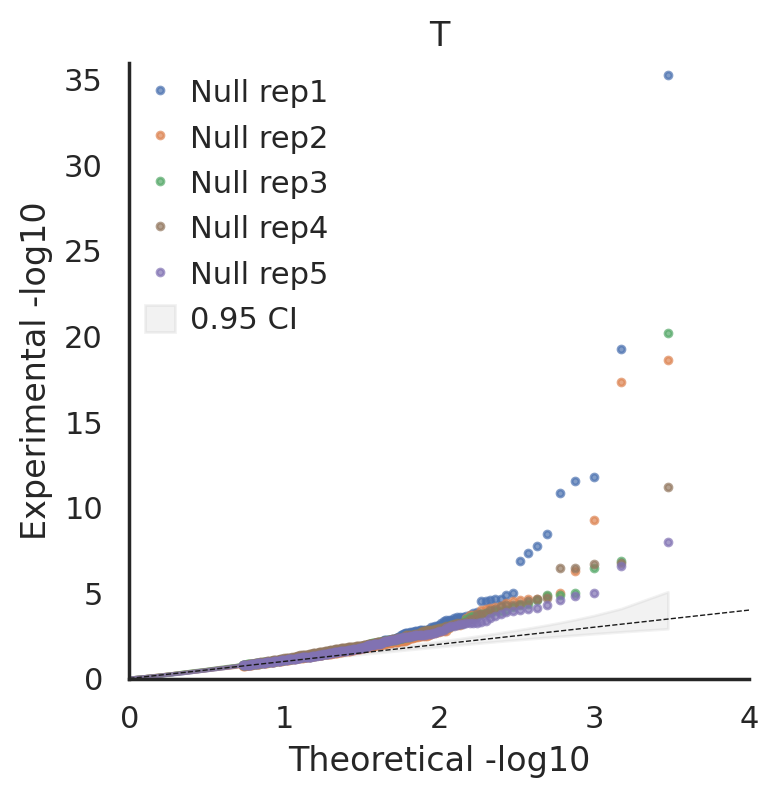

In [109]:
## qqplot: null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'][1:], [f'Null rep{i}' for i in range(1,6)], 
       color=['C0', 'C1', 'C2', 'C5', 'C4'], shape=['.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

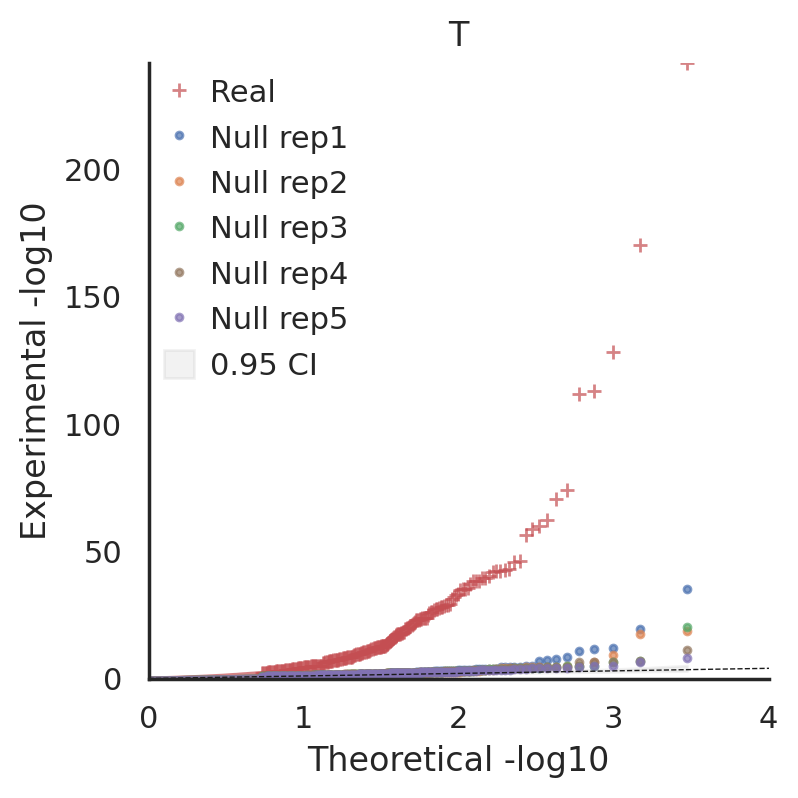

In [110]:
## qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'], ['Real']+[f'Null rep{i}' for i in range(1,6)], 
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['+','.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

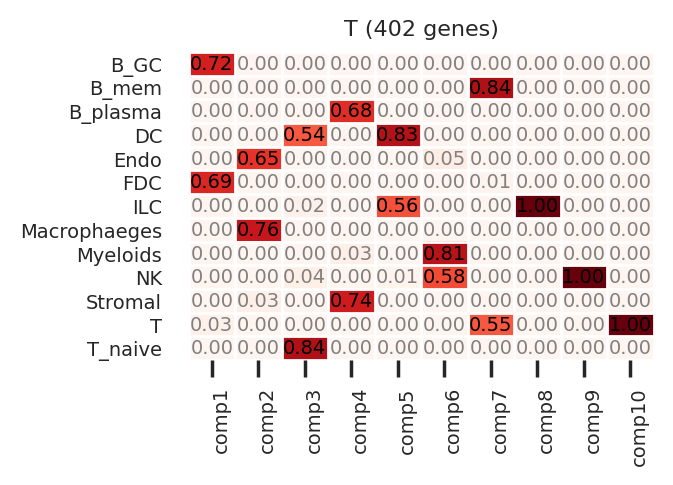

In [111]:
## v heatmap
sns.set_theme(style="white")
draw_v_heatmap(vdf, figsize=(3,2), title=f'{target_ct} ({len(udf)} genes)')

In [136]:
## select comps
draw_comps = [1,2,3,7]

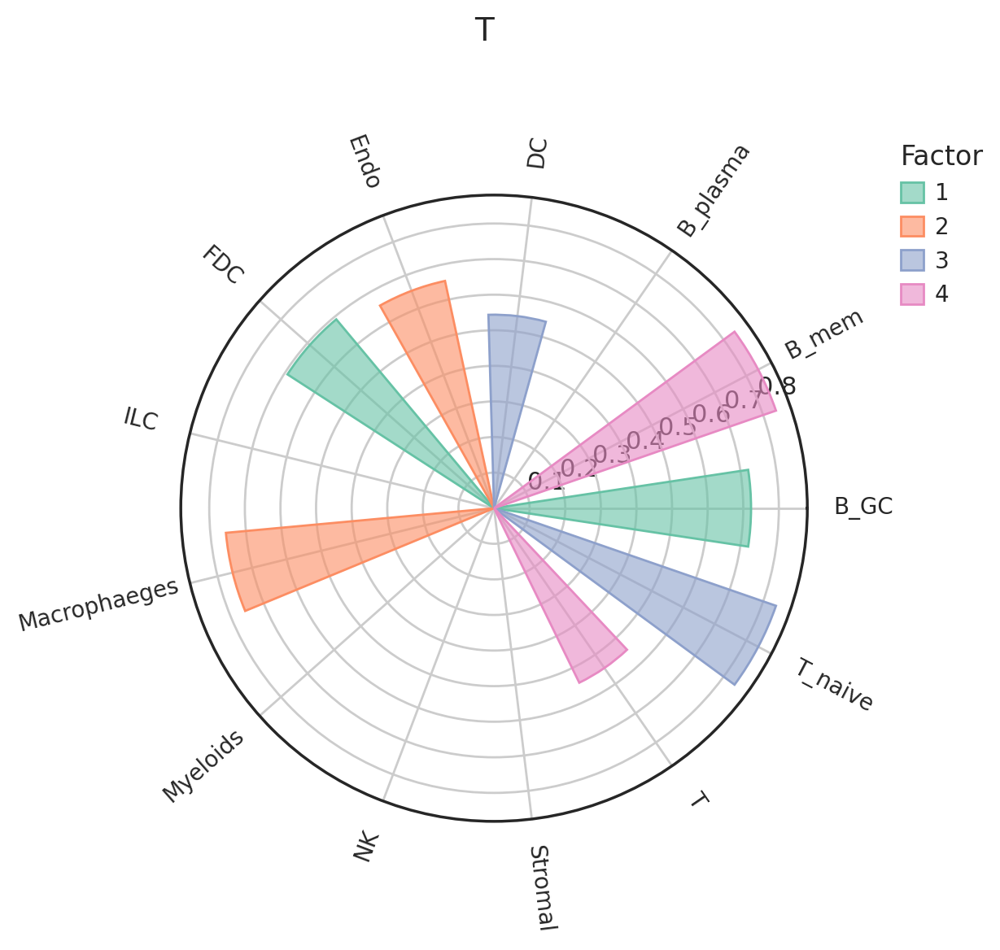

In [137]:
## v circular
sns.set_theme(style='white')
draw_v_circular(vdf, draw_comps, v_thres=0.1, cmap=mpl.colormaps['Set2'], figsize=(5,5), dpi=200, title=target_ct)

In [138]:
## niche scores
XY_loc_df = compute_score(crop, udf, vdf, target_ct, meta['N_target'], meta['loc_target'], meta['use_group_ids'])

Computed niche-related scores: XY_loc_df (5755, 436).


In [240]:
## save result
save_objs = {'udf': udf,
             'vdf': vdf,
             'meta': meta,
             'XY_loc_df': XY_loc_df}
filename = f'crop{crop_id}_{target_ct}.pkl'
with open(f'{save_dir}/{filename}', 'wb') as f:
    pickle.dump(save_objs, f)

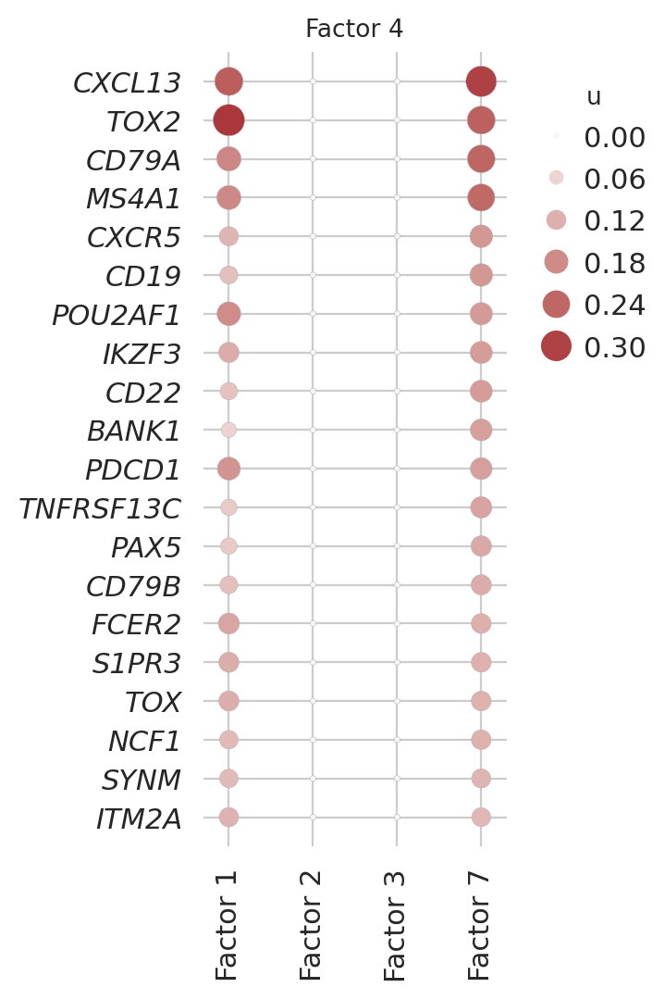

In [158]:
## u dotmap
focus_comp = 7
n_top_gene = 20
h = 0.25 * n_top_gene
u_title = f"Factor {draw_comps.index(focus_comp)+1}"
xticklabels = [f"Factor {x}" for x in draw_comps]
draw_u_dotmap(udf, focus_comp, draw_comps, n_top_gene, (5, 150), xticklabels,
                fs=11, h=h, w=3, title=u_title, mx=0.1, my=0.04, leg_pos=(1.1,0.95), dpi=200)

In [145]:
## kde diff: concord
kde_comp = 7
t0 = time.time()
Z, lims, draw_ids = kde_diff(XY_loc_df, kde_comp, score='concord', z_quantile=0.99, bw=20)
print(f'KDE diff: {time.time() - t0:.1f}s')

KDE diff: 54.2s


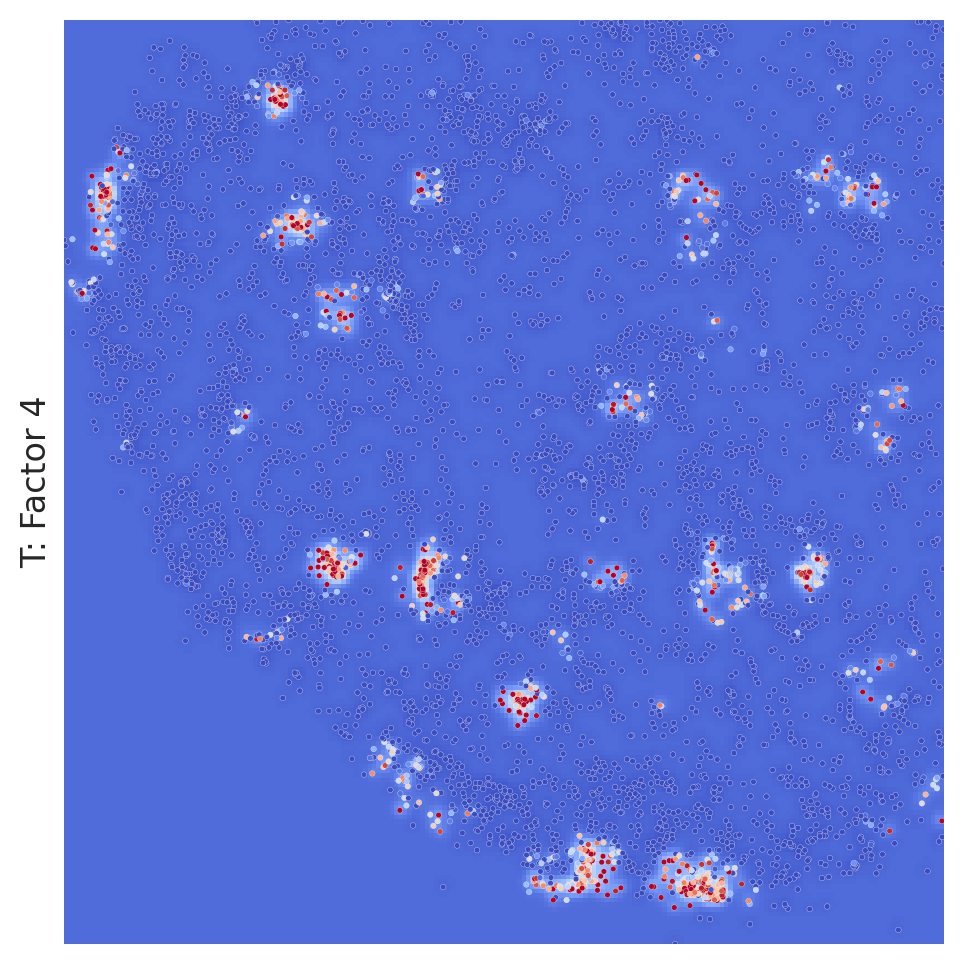

In [146]:
## kde diff: concord
draw_kde_diff(XY_loc_df, kde_comp, target_ct, Z, lims, draw_ids, score='concord',
                  use_quant=0.99, draw_points=True, cmap=mpl.colormaps['coolwarm'], 
                  ylabel=f'{target_ct}: Factor {draw_comps.index(kde_comp)+1}', fs=12, title=None, figsize=(7, 6), dpi=200)

In [153]:
## sub cell type count of one factor
subct_comp = 7
score_df = XY_loc_df.copy()
subcts = [x for x in score_df.sub_cell_type.unique() if x.startswith('T')]
count_df = sub_ct_enrich(subct_comp, score_df, subcts, score='concord', q1=0.9, q2=0.95)
count_df

,base,obs_high_09,obs_high_095,exp_high_09,exp_high_095,fold_09,fold_095
sub_cell_type,,,,,,,
T_CD4+_TfH_GC,1187,378,205,118,59,3.203390,3.474576
T_CD8+_cytotoxic,1303,114,50,130,65,0.876923,0.769231
T_TfR,472,25,14,47,23,0.531915,0.608696
T_TIM3+,1771,45,14,177,88,0.254237,0.159091
T_Treg,886,14,5,88,44,0.159091,0.113636
T_CD4+,136,0,0,13,6,0.000000,0.000000


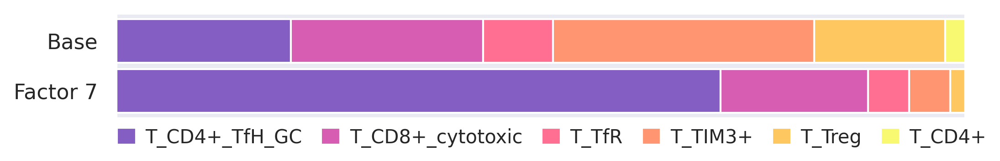

In [154]:
## sub cell type proportion of this factor
sns.set_theme(style="darkgrid")
# colors = mpl.colormaps['Set2'].colors
color_map = {'T_CD4+_TfH_GC': '#845ec2',
             'T_CD8+_cytotoxic': '#d65db1',
             'T_TfR': '#ff6f91',
             'T_TIM3+': '#ff9671',
             'T_Treg': '#ffc75f',
             'T_CD4+': '#f9f871'}
colors = [color_map[k] for k in count_df.index.tolist()]
draw_sub_ct_prop(count_df, alphabet=False, figsize=(8,1), dpi=300, h=0.35, yticks=[0, 0.4], 
                     yticklabels=['Base', f'Factor {subct_comp}'], colors=colors, ylim=(-0.22,0.62))

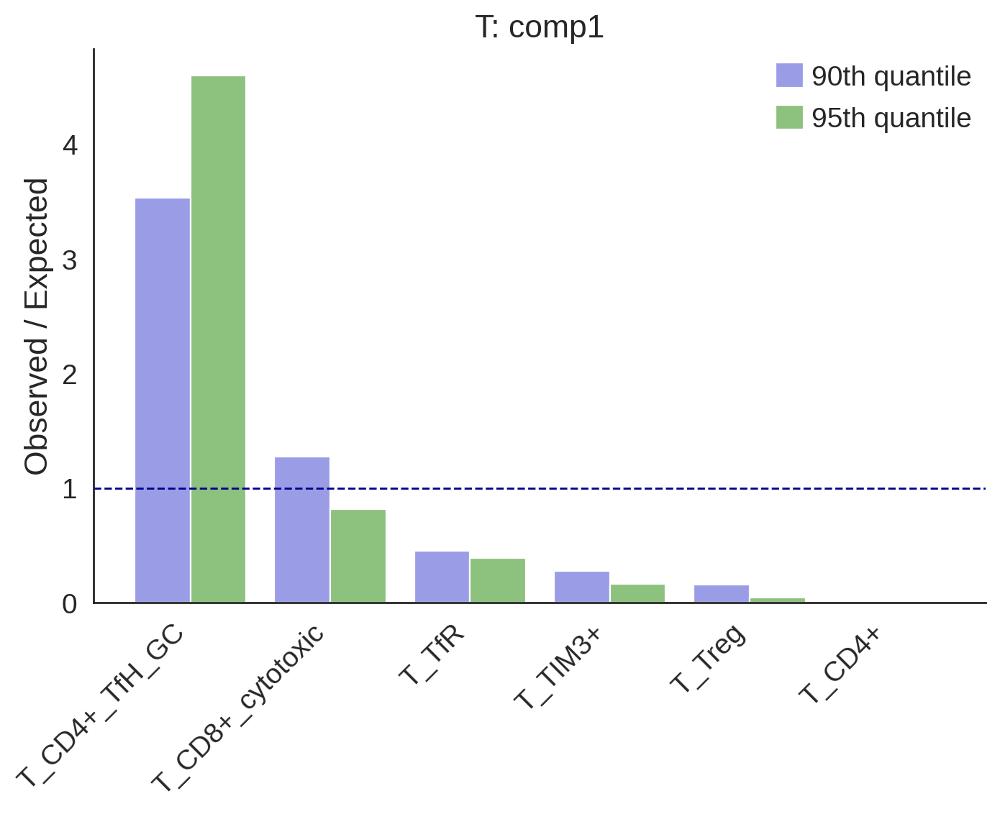

In [274]:
## enrichment folds
draw_sub_ct_enrich(count_df, figsize=(8,5), dpi=200, fs=14, width=0.4, alpha=1, title=None)

In [159]:
## combine go results
u_thres = [0.05, 0.05, 0.05, 0.05]
# u_top = 15
wdf12 = go_combine(udf, vdf, draw_comps, u_thres=u_thres, u_top=None, pval_thres=0.05, n_top=15, enrichr_cutoff=0.1)
print(wdf12['-log10_padj'].min(),round(wdf12['-log10_padj'].max(),1),wdf12['num_gene'].min(),round(wdf12['num_gene'].max(),1))

1 ['B_GC', 'FDC'] 103 15
2 ['Endo', 'Macrophaeges'] 86 15
3 ['DC', 'T_naive'] 83 15
7 ['B_mem', 'T'] 84 15
0.0 10.5 0.0 19.0


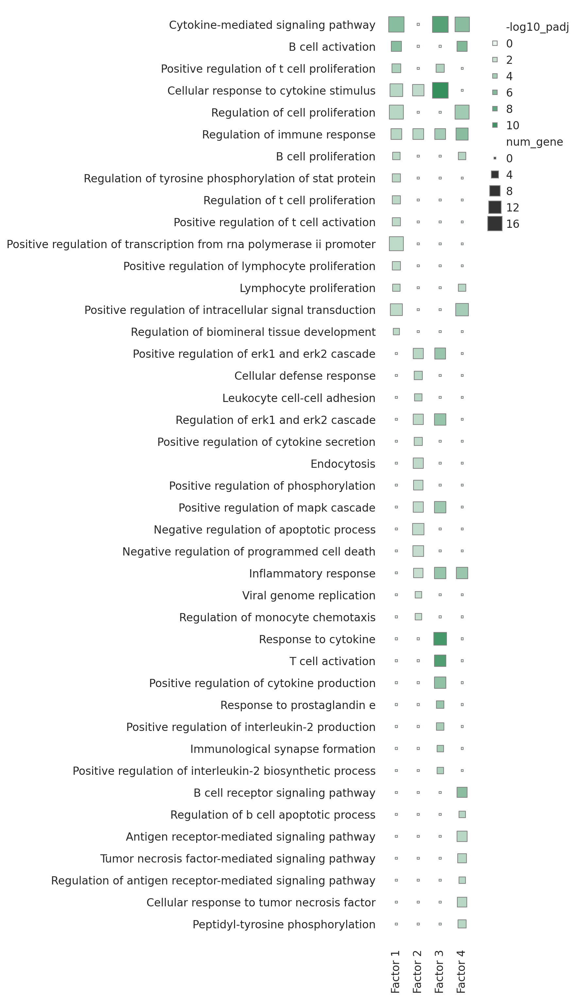

In [160]:
## draw combined go results
draw_go_combine(wdf12, draw_comps, dpi=200, sizes=(5,300), height=15,
                hue_norm=(0,np.ceil(wdf12['-log10_padj'].max())), 
                size_norm=(0,wdf12['num_gene'].max()),
                fs=12, mx=0.2, my=0.02, leg_pos=(0.76,0.98), title=None)

In [166]:
## ora
ora_comp = 'comp3'
ora_u_thres = 0.1
clist = vdf.loc[vdf[ora_comp] > 0.2].index.tolist()
print(clist)
glist = udf.loc[udf[ora_comp] > ora_u_thres].index.tolist()
glist = udf.sort_values(ora_comp, ascending=False).iloc[:10].index.tolist()
print(len(glist))
enr_res = gseapy.enrichr(gene_list=glist,organism='Human',gene_sets=['GO_Biological_Process_2018'],cutoff = 0.1)
enr_res.res2d.loc[enr_res.res2d['Adjusted P-value']<0.05,['Term','Overlap','P-value','Adjusted P-value','Genes']]

['DC', 'T_naive']
10


,Term,Overlap,P-value,Adjusted P-value,Genes
0,cellular response to cytokine stimulus (GO:007...,7/456,3.460478e-10,9.343292e-08,CCL22;LEF1;S1PR1;FLT3LG;CCR7;CCL19;CCL17
1,monocyte chemotaxis (GO:0002548),3/41,9.499260e-07,7.585457e-05,CCL22;CCL19;CCL17
2,lymphocyte chemotaxis (GO:0048247),3/44,1.179263e-06,7.585457e-05,CCL22;CCL19;CCL17
3,positive regulation of GTPase activity (GO:004...,4/192,1.652276e-06,7.585457e-05,CCL22;CCR7;CCL19;CCL17
4,chemokine-mediated signaling pathway (GO:0070098),3/52,1.963692e-06,7.585457e-05,CCL22;CCL19;CCL17
5,positive regulation of ERK1 and ERK2 cascade (...,4/201,1.983051e-06,7.585457e-05,CCL22;CCR7;CCL19;CCL17
6,neutrophil chemotaxis (GO:0030593),3/53,2.080968e-06,7.585457e-05,CCL22;CCL19;CCL17
7,granulocyte chemotaxis (GO:0071621),3/56,2.460474e-06,7.585457e-05,CCL22;CCL19;CCL17
8,neutrophil migration (GO:1990266),3/58,2.737395e-06,7.585457e-05,CCL22;CCL19;CCL17
9,positive regulation of dendritic cell antigen ...,2/6,3.371314e-06,7.585457e-05,CCR7;CCL19


<Axes: title={'center': 'T: comp1 (u > 0.05)'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

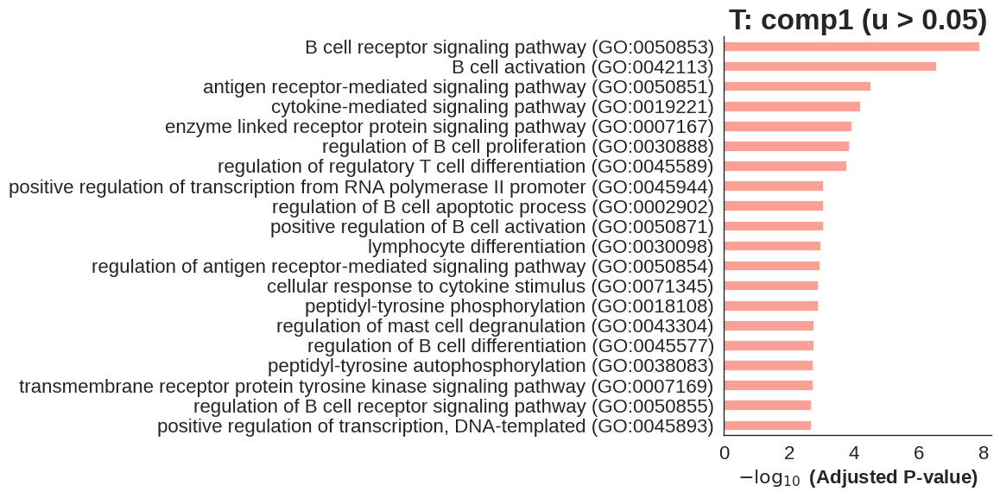

In [97]:
gseapy.barplot(enr_res.res2d,title=f'{target_ct}: {ora_comp} (u > {ora_u_thres})', top_term=20, cutoff=0.05)

## B_mem

In [213]:
## run method
target_ct = 'B_mem'
target_ct_abbr = target_ct
use_cov_test_genes = True
udf, vdf, meta = run_method(crop, target_ct,  target_ct_abbr, self=True,
                       sigma=20, cutoff=0.05, sort_comp_by_corr=False,
                       n_hvg=3000, cov_thres=0.05, cov_test_null=True,
                       use_cov_test_genes=use_cov_test_genes,
                       cca_comp=10, px=0.6, pz=0.4)

***** Niche matrix *****
13 cell_types.
num_cell_ID: (74851, 13).
Use other 13 cell types.
6653 B_mem, 74851 cells in total.

***** Cov test *****
sparkx_X: (2992, 6653); sparkx_N: (6653, 13)
2992 / 2992 genes have pvalue.
Cov test on permuted data...
349 genes with p_adj < 0.05.
Use all 349 genes with p_adj < 0.05.

***** CCA *****
cca_X: (6653, 349); cca_N: (6653, 13)
Nonneg CCA cors: [0.58  0.555 0.546 0.502 0.409 0.341 0.372 0.441 0.217 0.404]
udf: (349, 10); vdf: (13, 10).

B_mem: Finished in 17.7s.


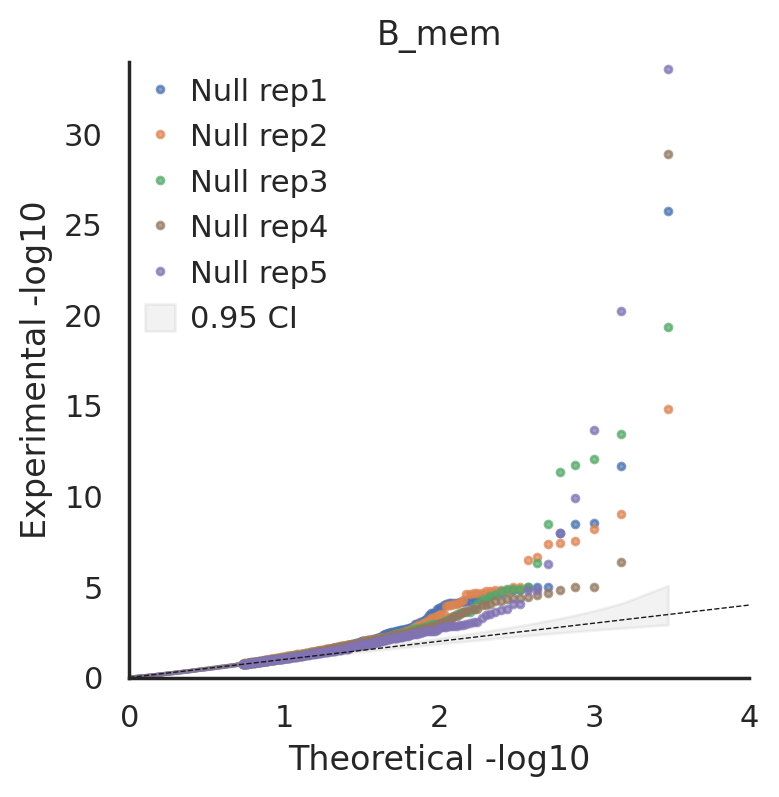

In [214]:
## qqplot: null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'][1:], [f'Null rep{i}' for i in range(1,6)], 
       color=['C0', 'C1', 'C2', 'C5', 'C4'], shape=['.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

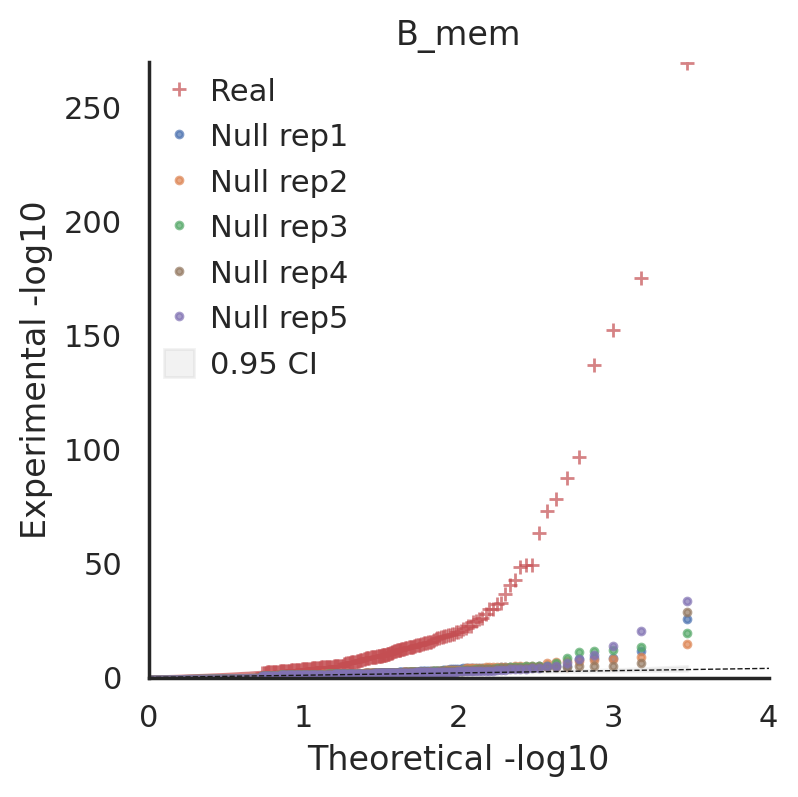

In [215]:
## qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'], ['Real']+[f'Null rep{i}' for i in range(1,6)], 
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['+','.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

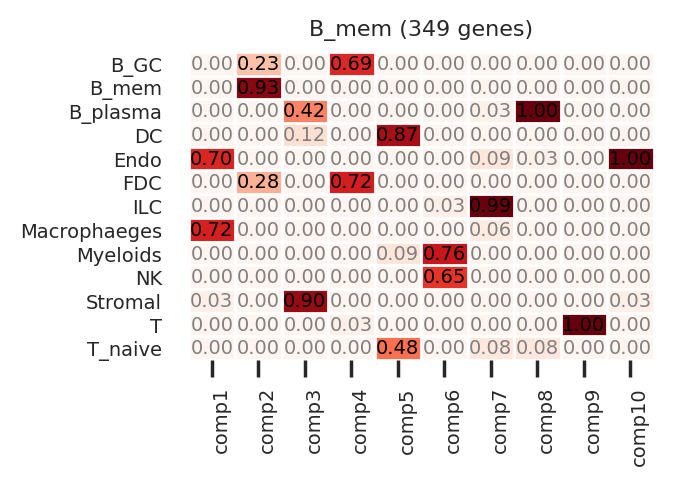

In [216]:
## v heatmap
sns.set_theme(style="white")
draw_v_heatmap(vdf, figsize=(3,2), title=f'{target_ct} ({len(udf)} genes)')

In [230]:
## select comps
draw_comps = [1,2,4,5]

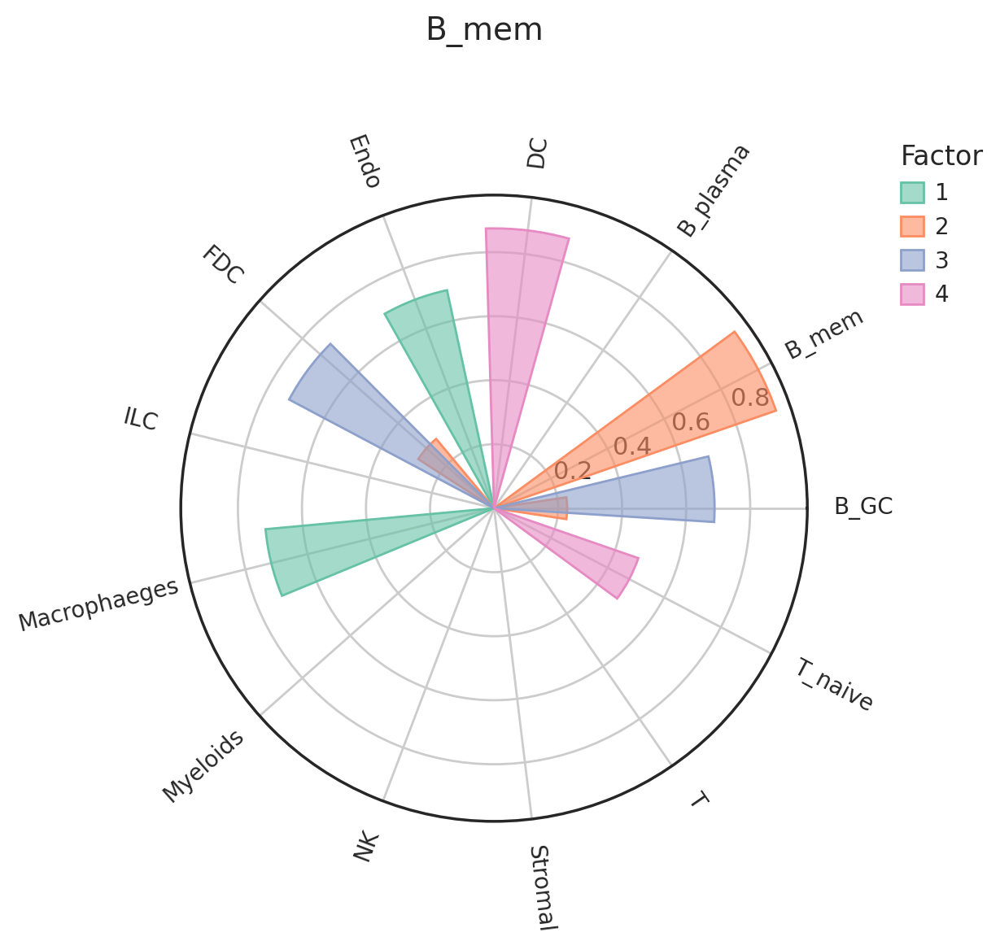

In [231]:
## v circular
sns.set_theme(style='white')
draw_v_circular(vdf, draw_comps, v_thres=0.1, cmap=mpl.colormaps['Set2'], figsize=(5,5), dpi=200, title=target_ct)

In [232]:
## niche scores
XY_loc_df = compute_score(crop, udf, vdf, target_ct, meta['N_target'], meta['loc_target'], meta['use_group_ids'])

Computed niche-related scores: XY_loc_df (6653, 383).


In [370]:
## save result
save_objs = {'udf': udf,
             'vdf': vdf,
             'meta': meta,
             'XY_loc_df': XY_loc_df}
filename = f'crop{crop_id}_{target_ct}.pkl'
with open(f'{save_dir}/{filename}', 'wb') as f:
    pickle.dump(save_objs, f)

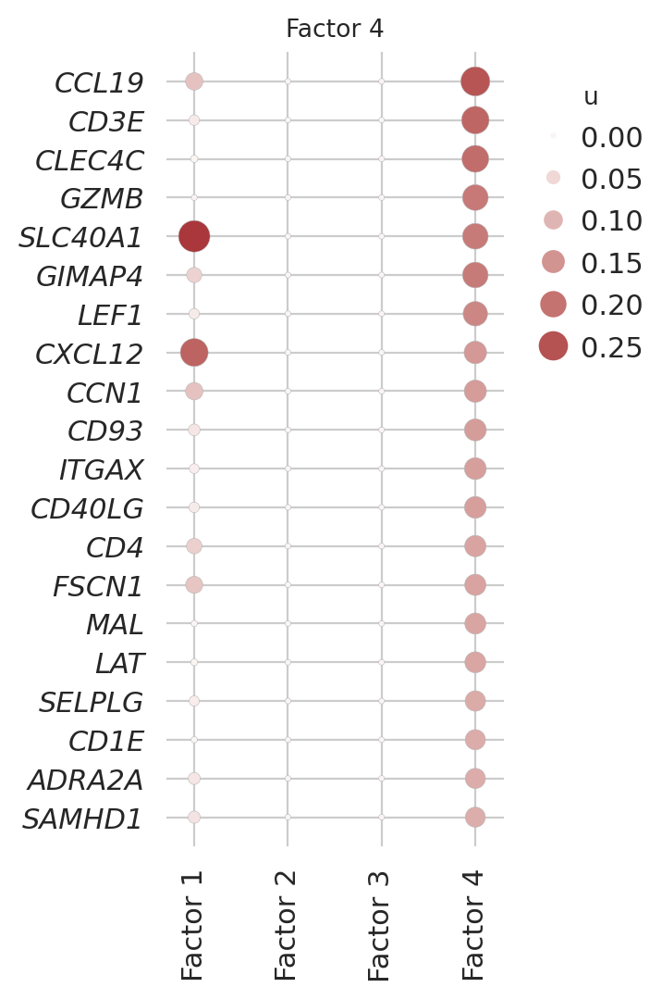

In [258]:
## u dotmap
focus_comp = 5
n_top_gene = 20
h = 0.25 * n_top_gene
u_title = f"Factor {draw_comps.index(focus_comp)+1}"
xticklabels = [f"Factor {x}" for x in range(1,len(draw_comps)+1)]
draw_u_dotmap(udf, focus_comp, draw_comps, n_top_gene, (5, 150), xticklabels,
                fs=11, h=h, w=3, title=u_title, mx=0.1, my=0.04, leg_pos=(1.1,0.95), dpi=200)

In [245]:
## kde diff: concord
kde_comp = 5
t0 = time.time()
Z, lims, draw_ids = kde_diff(XY_loc_df, kde_comp, score='concord', z_quantile=0.99, bw=20)
print(f'KDE diff: {time.time() - t0:.1f}s')

KDE diff: 60.0s


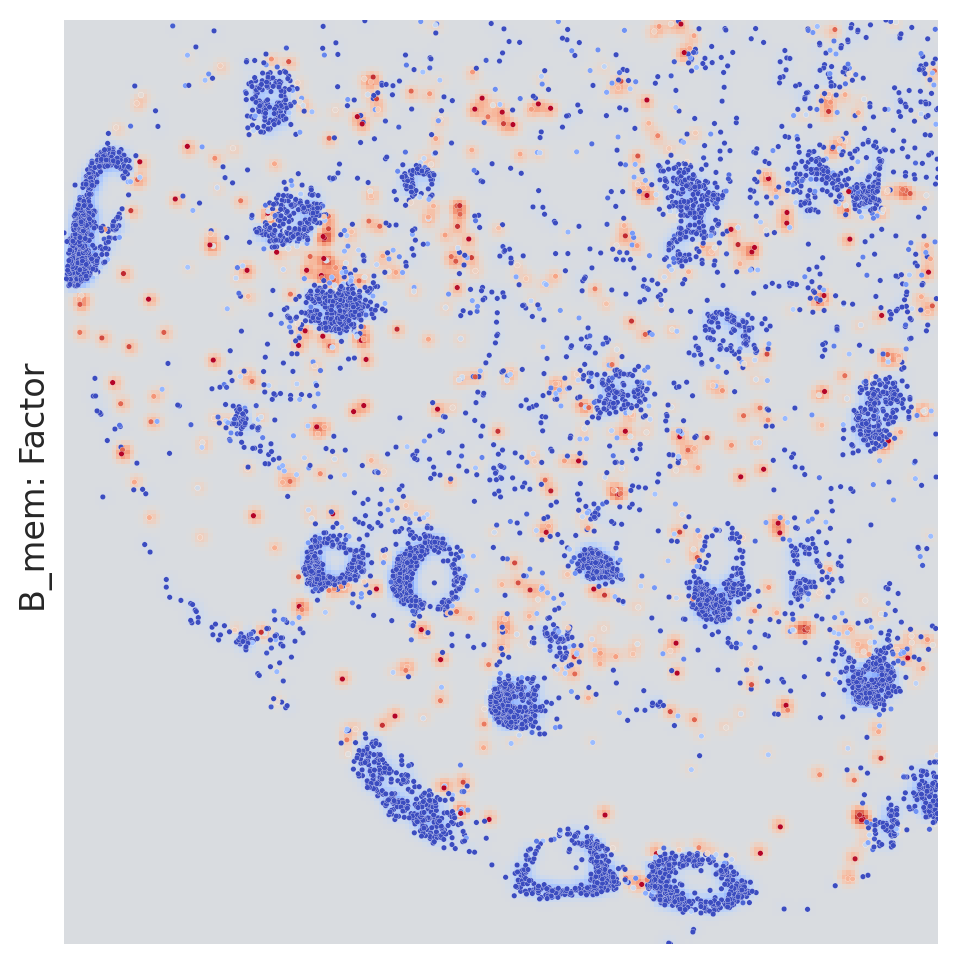

In [246]:
## kde diff: concord
draw_kde_diff(XY_loc_df, kde_comp, target_ct, Z, lims, draw_ids, score='concord',
                  use_quant=0.99, draw_points=True, cmap=mpl.colormaps['coolwarm'], 
                  ylabel=f'{target_ct}: Factor ', fs=12, title=None, figsize=(7, 6), dpi=200)

In [253]:
## sub cell type count of one factor
subct_comp = 5
score_df = XY_loc_df.copy()
subcts = [x for x in score_df.sub_cell_type.unique() if x.startswith('B')]
count_df = sub_ct_enrich(subct_comp, score_df, subcts, score='concord', q1=0.9, q2=0.95)
count_df

,base,obs_high_09,obs_high_095,exp_high_09,exp_high_095,fold_09,fold_095
sub_cell_type,,,,,,,
B_IFN,628,65,35,62,31,1.048387,1.129032
B_preGC,590,61,31,59,29,1.033898,1.068966
B_activated,116,12,5,11,5,1.090909,1.000000
B_mem,4623,461,230,462,231,0.997835,0.995671
B_naive,696,67,32,69,34,0.971014,0.941176


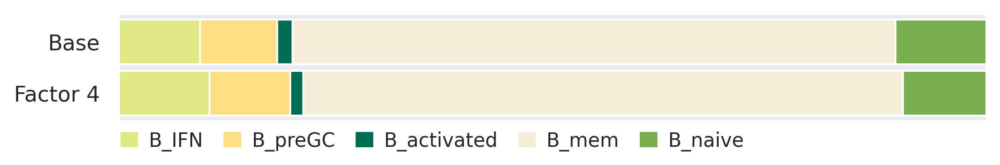

In [254]:
## sub cell type proportion of this factor
sns.set_theme(style="darkgrid")
# colors = mpl.colormaps['Set2'].colors
color_map = {'B_activated': '#006F51',
             'B_naive': '#78ae4d',
             'B_IFN': '#e1e986',
             'B_preGC': '#ffdf82',
             'B_mem': '#f6edd9'}
colors = [color_map[k] for k in count_df.index.tolist()]
draw_sub_ct_prop(count_df, alphabet=False, figsize=(8,1), dpi=300, h=0.35, yticks=[0, 0.4], 
                     yticklabels=['Base', f'Factor {draw_comps.index(subct_comp)+1}'], colors=colors, ylim=(-0.22,0.62))

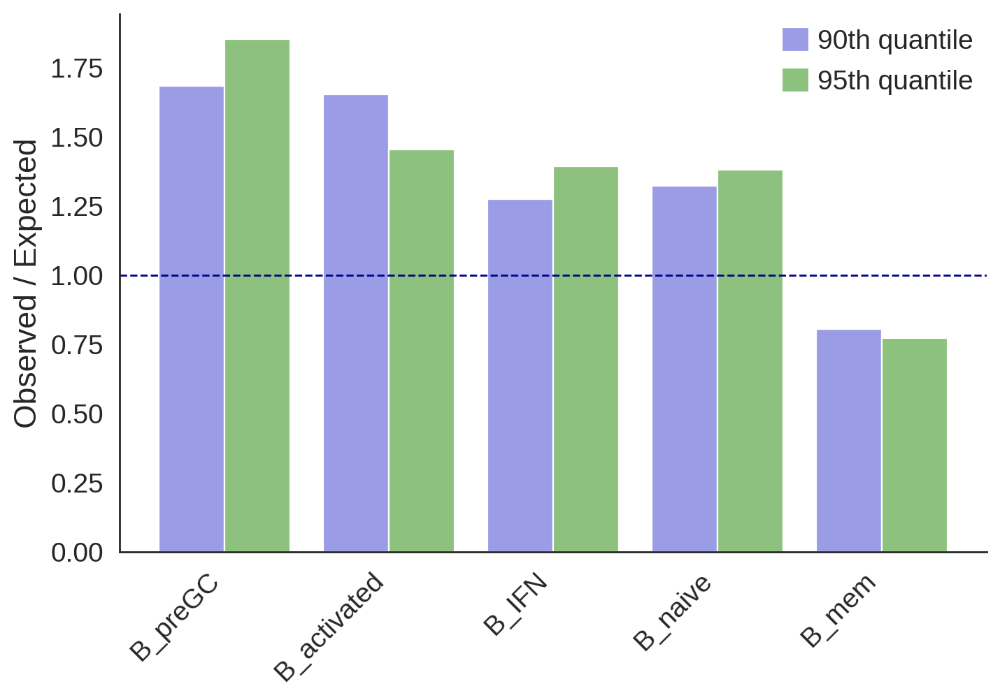

In [393]:
## enrichment folds
draw_sub_ct_enrich(count_df, figsize=(8,5), dpi=200, fs=14, width=0.4, alpha=1, title=None)

In [233]:
## combine go results
u_thres = [0.05, 0.05, 0.05, 0.05]
# u_thres = [0.1, 0.1, 0.1, 0.1]
u_top = 15
wdf12 = go_combine(udf, vdf, draw_comps, u_thres=u_thres, u_top=None, pval_thres=0.05, n_top=15, enrichr_cutoff=0.1)
print(wdf12['-log10_padj'].min(),round(wdf12['-log10_padj'].max(),1),wdf12['num_gene'].min(),round(wdf12['num_gene'].max(),1))

1 ['Endo', 'Macrophaeges'] 97 15
2 ['B_GC', 'B_mem', 'FDC'] 61 15
4 ['B_GC', 'FDC'] 56 15
5 ['DC', 'T_naive'] 94 15
0.0 7.9 0.0 20.0


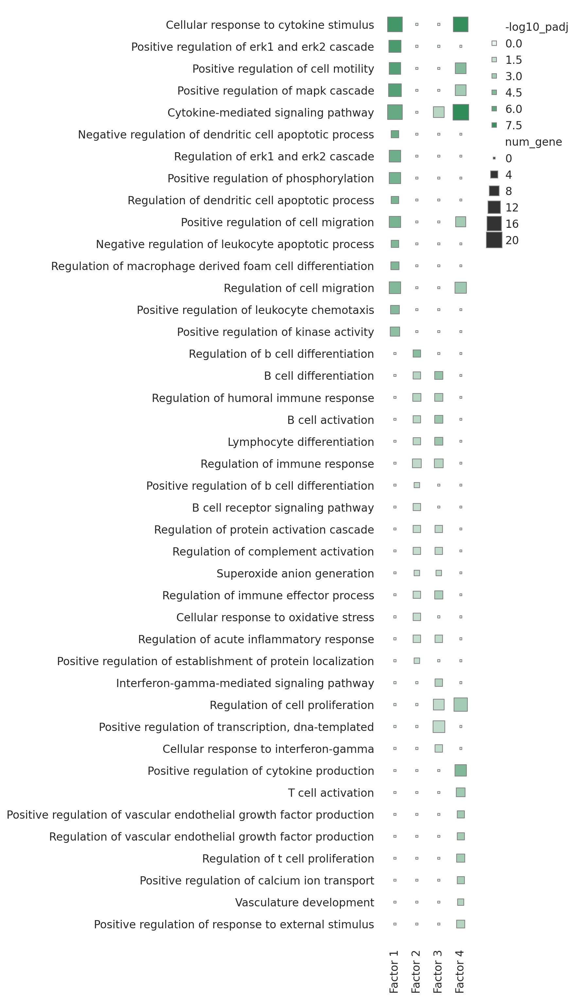

In [234]:
## draw combined go results
draw_go_combine(wdf12, draw_comps, dpi=200, sizes=(5,300), height=15,
                hue_norm=(0,np.ceil(wdf12['-log10_padj'].max())), 
                size_norm=(0,wdf12['num_gene'].max()),
                fs=12, mx=0.2, my=0.02, leg_pos=(0.76,0.98), title=None)

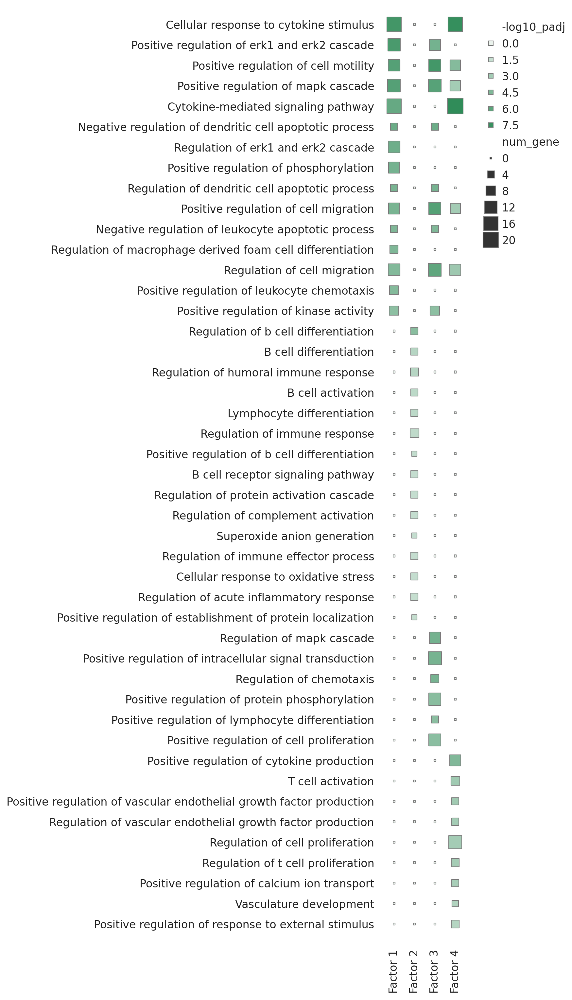

In [229]:
## draw combined go results
draw_go_combine(wdf12, draw_comps, dpi=200, sizes=(5,300), height=15,
                hue_norm=(0,np.ceil(wdf12['-log10_padj'].max())), 
                size_norm=(0,wdf12['num_gene'].max()),
                fs=12, mx=0.2, my=0.02, leg_pos=(0.76,0.98), title=None)

In [224]:
## ora
ora_comp = 'comp3'
ora_u_thres = 0.05
clist = vdf.loc[vdf[ora_comp] > 0.2].index.tolist()
print(clist)
glist = udf.loc[udf[ora_comp] > ora_u_thres].index.tolist()
print(len(glist))
enr_res = gseapy.enrichr(gene_list=glist,organism='Human',gene_sets=['GO_Biological_Process_2018'],cutoff = 0.1)
enr_res.res2d.loc[enr_res.res2d['Adjusted P-value']<0.05,['Term','Overlap','P-value','Adjusted P-value','Genes']]

['B_plasma', 'Stromal']
97


,Term,Overlap,P-value,Adjusted P-value,Genes
0,positive regulation of cell motility (GO:2000147),12/179,6.710172e-11,8.112598e-08,PDGFRB;PDGFRA;XBP1;MMP14;CXCL12;SEMA4B;LEF1;SN...
1,positive regulation of cell migration (GO:0030...,12/221,7.671108e-10,4.637185e-07,PDGFRB;PDGFRA;XBP1;MMP14;CXCL12;SEMA4B;LEF1;GA...
2,positive regulation of MAPK cascade (GO:0043410),13/289,1.442368e-09,5.812744e-07,PDGFRB;PDGFRA;ADRA2C;ADRA1A;SCIMP;ADRA2A;TNFRS...
3,regulation of cell migration (GO:0030334),13/316,4.240950e-09,1.281827e-06,PDGFRB;PDGFRA;XBP1;SEMA4B;LEF1;THBS1;ADRA2A;MY...
4,negative regulation of dendritic cell apoptoti...,4/7,1.799080e-08,4.350176e-06,CXCL12;AXL;CCL19;GAS6
5,positive regulation of ERK1 and ERK2 cascade (...,10/201,4.944687e-08,9.375755e-06,PDGFRB;PDGFRA;CD4;AXL;TNFSF11;CCL19;GAS6;ADRA1...
6,regulation of MAPK cascade (GO:0043408),10/203,5.428477e-08,9.375755e-06,PDGFRB;PDGFRA;CD4;AXL;ADRA2C;ADRA1A;EPHA3;ADRA...
7,positive regulation of intracellular signal tr...,14/479,7.693332e-08,1.162655e-05,PDGFRB;PDGFRA;GAB1;ADRA2C;ADRA1A;THBS1;ADRA2A;...
8,regulation of chemotaxis (GO:0050920),5/24,9.552988e-08,1.283285e-05,PDGFRB;PDGFRA;ADGRA2;CCL19;THBS1
9,regulation of dendritic cell apoptotic process...,4/10,1.067480e-07,1.290583e-05,CXCL12;AXL;CCL19;GAS6


In [ ]:
gseapy.barplot(enr_res.res2d,title=f'{target_ct}: {ora_comp} (u > {ora_u_thres})', top_term=20, cutoff=0.05)

## B_GC

In [261]:
## run method
target_ct = 'B_GC'
target_ct_abbr = target_ct
use_cov_test_genes = True
udf, vdf, meta = run_method(crop, target_ct,  target_ct_abbr, self=True,
                       sigma=20, cutoff=0.05, sort_comp_by_corr=False, max_cand_genes=500,
                       n_hvg=3000, cov_thres=0.05, cov_test_null=True,
                       use_cov_test_genes=use_cov_test_genes,
                       cca_comp=10, px=0.6, pz=0.4)

***** Niche matrix *****
13 cell_types.
num_cell_ID: (74851, 13).
Use other 13 cell types.
4071 B_GC, 74851 cells in total.

***** Cov test *****
sparkx_X: (2957, 4071); sparkx_N: (4071, 13)
2957 / 2957 genes have pvalue.
Cov test on permuted data...
689 genes with p_adj < 0.05.
Use top 500 genes with p_adj < 0.05.

***** CCA *****
cca_X: (4071, 500); cca_N: (4071, 13)
Nonneg CCA cors: [0.564 0.705 0.518 0.492 0.444 0.509 0.548 0.516 0.553 0.369]
udf: (500, 10); vdf: (13, 10).

B_GC: Finished in 11.3s.


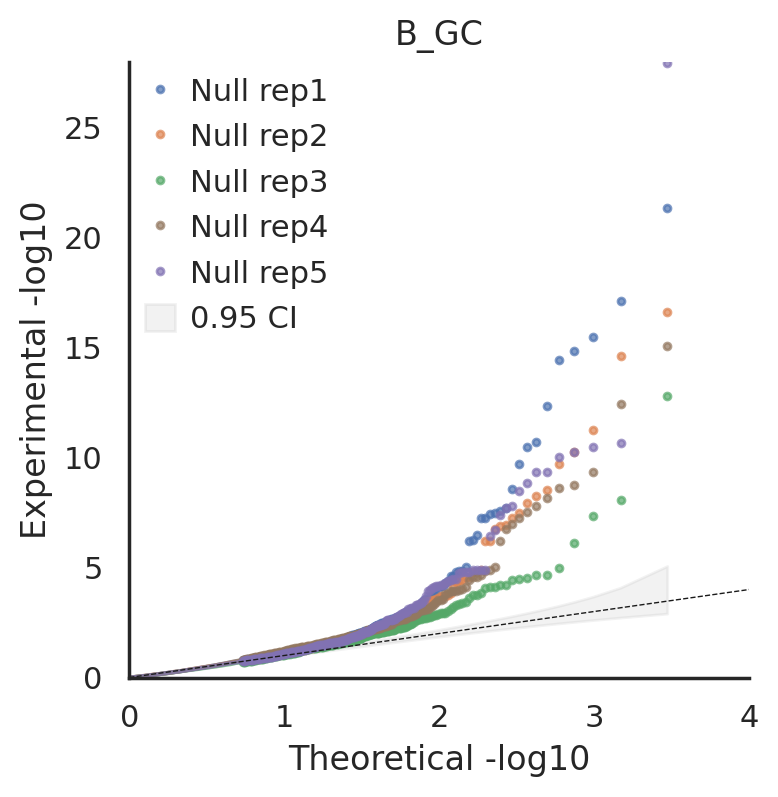

In [168]:
## qqplot: null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'][1:], [f'Null rep{i}' for i in range(1,6)], 
       color=['C0', 'C1', 'C2', 'C5', 'C4'], shape=['.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

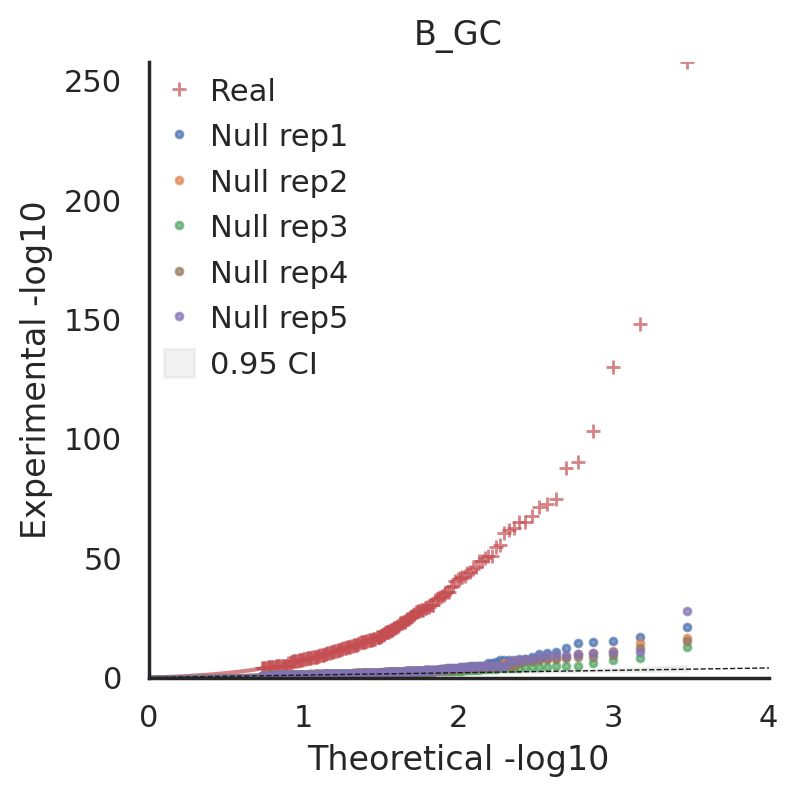

In [169]:
## qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'], ['Real']+[f'Null rep{i}' for i in range(1,6)], 
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['+','.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

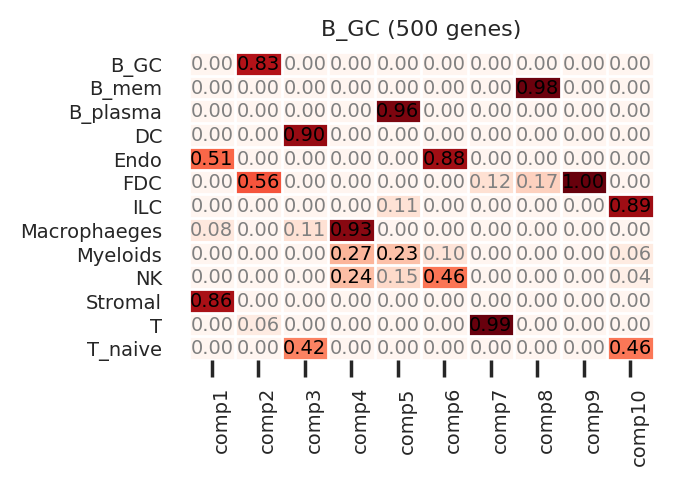

In [262]:
## v heatmap
sns.set_theme(style="white")
draw_v_heatmap(vdf, figsize=(3,2), title=f'{target_ct} ({len(udf)} genes)')

In [185]:
## select comps
draw_comps = [2,3,4,8]

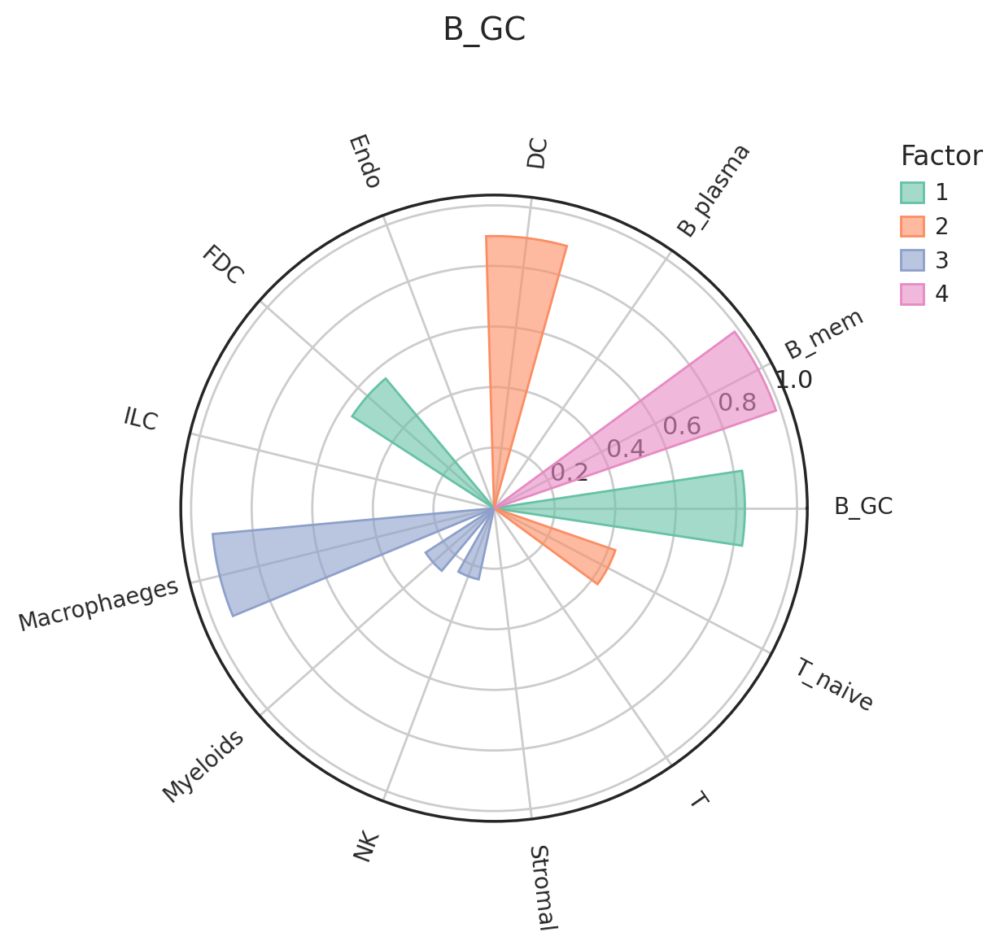

In [186]:
## v circular
sns.set_theme(style='white')
draw_v_circular(vdf, draw_comps, v_thres=0.2, cmap=mpl.colormaps['Set2'], figsize=(5,5), dpi=200, title=target_ct)

In [187]:
## niche scores
XY_loc_df = compute_score(crop, udf, vdf, target_ct, meta['N_target'], meta['loc_target'], meta['use_group_ids'])

Computed niche-related scores: XY_loc_df (4071, 534).


In [751]:
## save result
save_objs = {'udf': udf,
             'vdf': vdf,
             'meta': meta,
             'XY_loc_df': XY_loc_df}
filename = f'crop{crop_id}_{target_ct}.pkl'
with open(f'{save_dir}/{filename}', 'wb') as f:
    pickle.dump(save_objs, f)

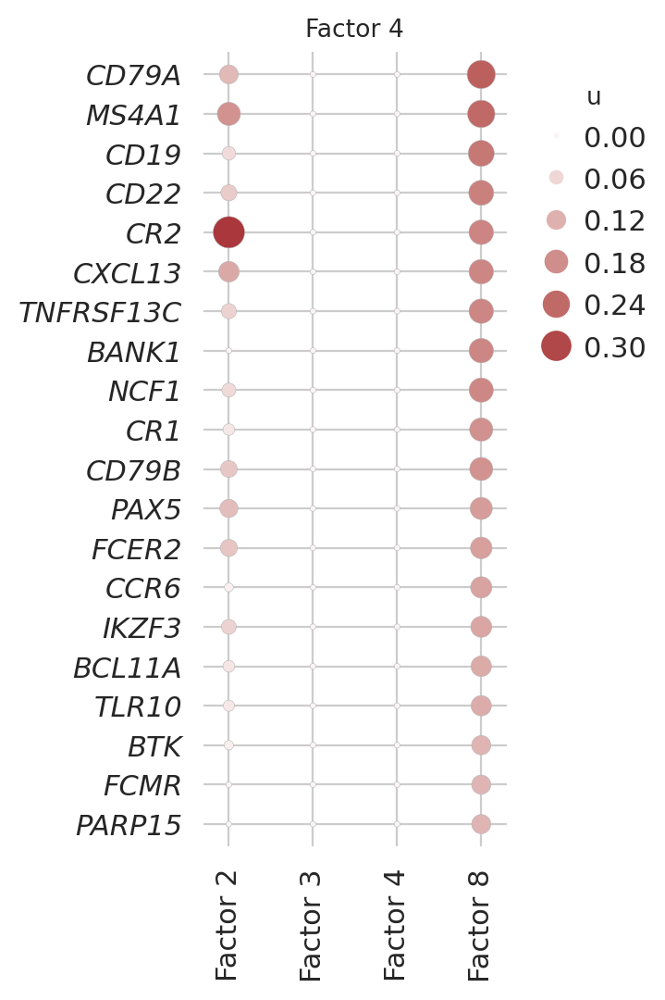

In [212]:
## u dotmap
focus_comp = 8
n_top_gene = 20
h = 0.25 * n_top_gene
u_title = f"Factor {draw_comps.index(focus_comp)+1}"
xticklabels = [f"Factor {x}" for x in draw_comps]
draw_u_dotmap(udf, focus_comp, draw_comps, n_top_gene, (5, 150), xticklabels,
                fs=11, h=h, w=3, title=u_title, mx=0.1, my=0.03, leg_pos=(1.1,0.95), dpi=200)

In [198]:
## kde diff: concord
kde_comp = 8
t0 = time.time()
Z, lims, draw_ids = kde_diff(XY_loc_df, kde_comp, score='concord', z_quantile=0.99, bw=20)
print(f'KDE diff: {time.time() - t0:.1f}s')

KDE diff: 34.9s


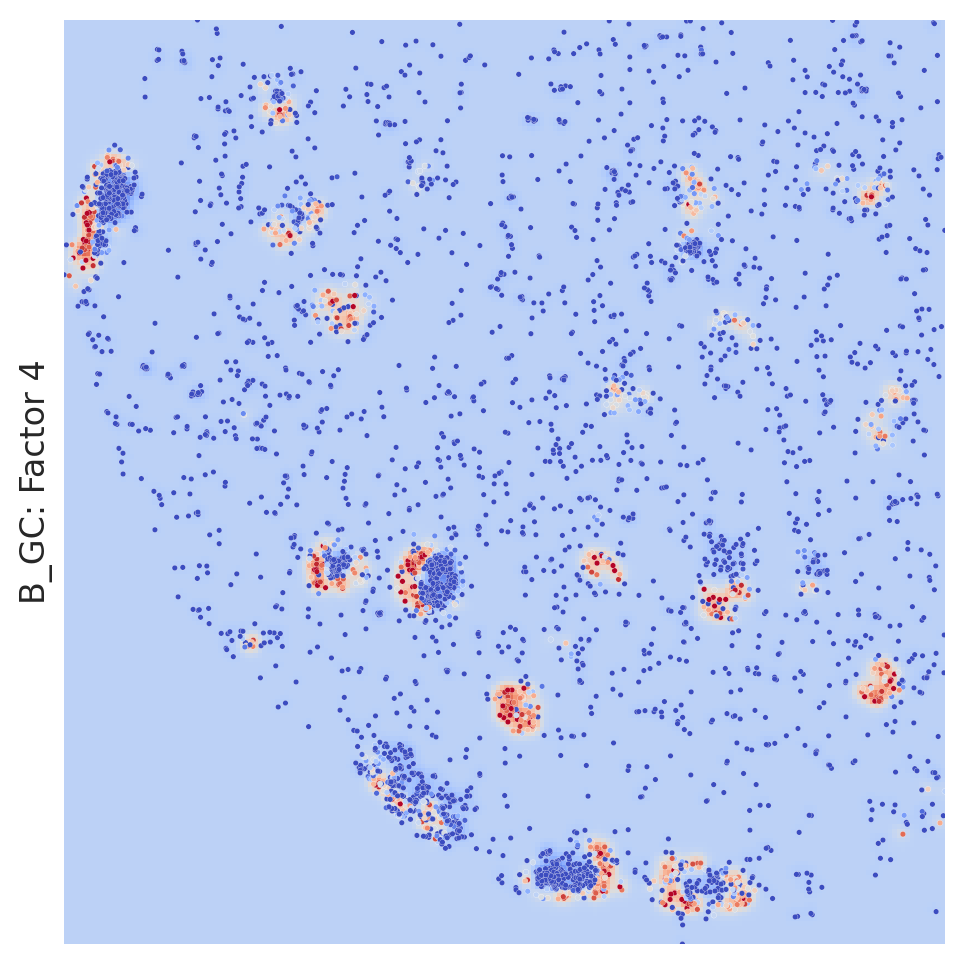

In [199]:
## kde diff: concord
draw_kde_diff(XY_loc_df, kde_comp, target_ct, Z, lims, draw_ids, score='concord',
                  use_quant=0.99, draw_points=True, cmap=mpl.colormaps['coolwarm'], 
                  ylabel=f'{target_ct}: Factor {draw_comps.index(kde_comp)+1}', fs=12, title=None, figsize=(7, 6), dpi=200)

In [206]:
## sub cell type count of one factor
subct_comp = 8
score_df = XY_loc_df.copy()
subcts = [x for x in score_df.sub_cell_type.unique() if x.startswith('B')]
count_df = sub_ct_enrich(subct_comp, score_df, subcts, score='concord', q1=0.9, q2=0.95)
count_df

,base,obs_high_09,obs_high_095,exp_high_09,exp_high_095,fold_09,fold_095
sub_cell_type,,,,,,,
B_GC_LZ,1675,314,160,167,83,1.880240,1.927711
B_GC_DZ,515,67,34,51,25,1.313725,1.360000
B_Cycling,1881,26,10,188,94,0.138298,0.106383


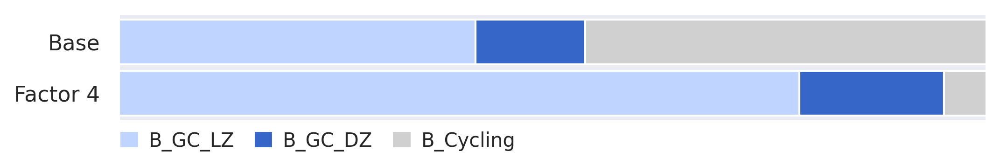

In [207]:
## sub cell type proportion of this factor
sns.set_theme(style="darkgrid")
# colors = mpl.colormaps['Set2'].colors
color_map = {'B_GC_LZ': '#bfd4ff',
             'B_GC_prePB': '#848596',
             'B_GC_DZ': '#3666C8',
             'B_Cycling': '#D0D0D0'}
colors = [color_map[k] for k in count_df.index.tolist()]
draw_sub_ct_prop(count_df, alphabet=False, figsize=(8,1), dpi=300, h=0.35, yticks=[0, 0.4], 
                     yticklabels=['Base', f'Factor {draw_comps.index(subct_comp)+1}'], colors=colors, ylim=(-0.22,0.62))

In [ ]:
## enrichment folds
draw_sub_ct_enrich(count_df, figsize=(8,5), dpi=200, fs=14, width=0.4, alpha=1, title=None)

In [188]:
## combine go results
# u_thres = [0.05, 0.05, 0.05, 0.05]
# u_thres = [0.1, 0.1, 0.1, 0.1]
u_top = 15
wdf12 = go_combine(udf, vdf, draw_comps, u_thres=None, u_top=u_top, pval_thres=0.05, n_top=15, enrichr_cutoff=0.1)
print(wdf12['-log10_padj'].min(),round(wdf12['-log10_padj'].max(),1),wdf12['num_gene'].min(),round(wdf12['num_gene'].max(),1))

2 ['B_GC', 'FDC'] 15 15
3 ['DC', 'T_naive'] 15 15
4 ['Macrophaeges', 'Myeloids', 'NK'] 15 15
8 ['B_mem'] 15 15
0.0 6.6 0.0 5.0


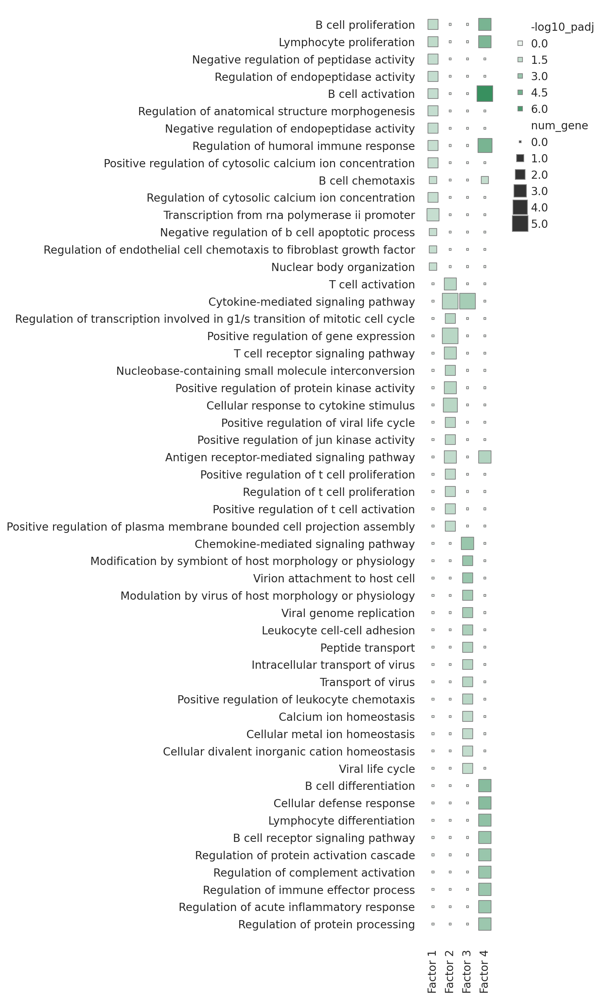

In [191]:
## draw combined go results
draw_go_combine(wdf12, draw_comps, dpi=200, sizes=(5,300), height=15,
                hue_norm=(0,np.ceil(wdf12['-log10_padj'].max())), 
                size_norm=(0,wdf12['num_gene'].max()),
                fs=12, mx=0.2, my=0.02, leg_pos=(0.77,0.98), title=None)

In [184]:
## ora
ora_comp = 'comp4'
ora_u_top = 15
ora_u_thres = 0.05
clist = vdf.loc[vdf[ora_comp] > 0.2].index.tolist()
print(clist)
glist = udf.loc[udf[ora_comp] > ora_u_thres].index.tolist()
tmp = udf.sort_values(ora_comp, ascending=False).iloc[:ora_u_top]
glist = tmp.index.tolist()
print(len(glist), tmp[ora_comp].min(), tmp[ora_comp].max())
enr_res = gseapy.enrichr(gene_list=glist,organism='Human',gene_sets=['GO_Biological_Process_2018'],cutoff = 0.1)
enr_res.res2d.loc[enr_res.res2d['Adjusted P-value']<0.1,['Term','Overlap','P-value','Adjusted P-value','Genes']]

['Macrophaeges', 'Myeloids', 'NK']
15 0.1252903229231987 0.23244754262089878


,Term,Overlap,P-value,Adjusted P-value,Genes
0,chemokine-mediated signaling pathway (GO:0070098),3/52,0.000007,0.000941,CCL14;CXCL12;CXCL2
1,modification by symbiont of host morphology or...,2/7,0.000011,0.000941,CLEC4M;CD209
2,virion attachment to host cell (GO:0019062),2/9,0.000019,0.001074,CLEC4M;CD209
3,cytokine-mediated signaling pathway (GO:0019221),5/633,0.000072,0.002728,CCL14;IL33;CXCL12;F13A1;CXCL2
4,modulation by virus of host morphology or phys...,2/18,0.000080,0.002728,CLEC4M;CD209
5,viral genome replication (GO:0019079),2/22,0.000120,0.003427,CLEC4M;CD209
6,leukocyte cell-cell adhesion (GO:0007159),2/27,0.000182,0.004453,CLEC4M;CD209
7,peptide transport (GO:0015833),2/41,0.000423,0.009048,CLEC4M;CD209
8,intracellular transport of virus (GO:0075733),2/54,0.000735,0.012561,CLEC4M;CD209
9,transport of virus (GO:0046794),2/54,0.000735,0.012561,CLEC4M;CD209


<Axes: title={'center': 'B_GC: comp2 (u > 0.1)'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

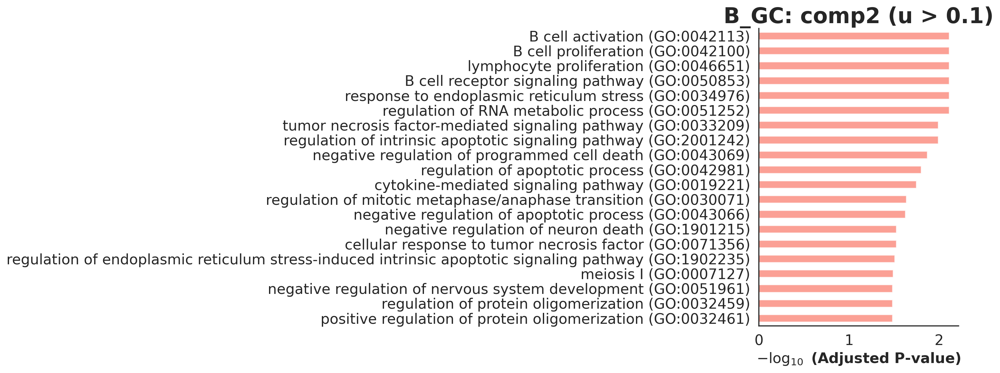

In [760]:
gseapy.barplot(enr_res.res2d,title=f'{target_ct}: {ora_comp} (u > {ora_u_thres})', top_term=20, cutoff=0.05)

## B_plasma